## Configuración inicial

A continuación se importan las librerías necesarias para el funcionamiento del notebook. 

In [2]:
#plots and data
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

#metrics and transformations
from sklearn.preprocessing import MinMaxScaler,StandardScaler
from sklearn.metrics import mean_squared_error
from sklearn import metrics

#Model 
from sklearn.neural_network import MLPRegressor
sns.set()

In [3]:
def plot_predict_test(df_test_y,testPredict,lag):
        ### Resultado predicción datos de entrenamiento
    print(testPredict.flatten())
    fig, ax = plt.subplots(figsize=[15,8])
    sns.lineplot(df_test_y.flatten(),label="real")
    sns.lineplot(testPredict.flatten(),label="predicción")
    plt.title("Comparación valor real y predicción")
    plt.ylabel("value")

In [4]:
def createLagFeature(name_features,lag,df):
    for name_feature in name_features:
        for i in range(1,lag+1):
            df[name_feature+"lag"+str(i)]=df[name_feature].shift(i)
    return df

In [5]:
#function to measure the performance
def timeseries_evaluation_metrics_func(y_true, y_pred,flag):
    def mean_absolute_percentage_error(y_true, y_pred): 
        epsilon=0.1e-5
        y_true, y_pred = np.array(y_true), np.array(y_pred)
        return np.mean(np.abs((y_true - y_pred) / y_true)) * 100
    
    if flag : print(f'R2 is : {metrics.r2_score(y_true, y_pred)}',end='\n\n')
    else:
        print('Evaluation metric results:')
        print(f'MSE is : {metrics.mean_squared_error(y_true, y_pred)}')
        print(f'MAE is : {metrics.mean_absolute_error(y_true, y_pred)}')
        print(f'RMSE is : {np.sqrt(metrics.mean_squared_error(y_true, y_pred))}')
        print(f'MAPE is : {mean_absolute_percentage_error(y_true, y_pred)}')
        
    return {"MSE":metrics.mean_squared_error(y_true, y_pred),
           "MAE":metrics.mean_absolute_error(y_true, y_pred),
           "RMSE":np.sqrt(metrics.mean_squared_error(y_true, y_pred)),
           "MAPE":mean_absolute_percentage_error(y_true, y_pred)}

---

## Cargar y preparar los datos.

In [4]:
df = pd.read_csv("../../Datasets/Datos_durante_pandemia/data_durante_vol_ve.csv")

df['Fecha'] = pd.to_datetime(df['Fecha'])
df = df.sort_values('Fecha', ascending=True)
df = df.rename(columns = {'Vol. Futuros': 'VolFuturos'})
df

,Fecha,VolFuturos,TRM,Precio Interno
0,2020-01-01,1.289946,3277.14,975000.0
1,2020-01-02,0.735046,3277.14,945000.0
2,2020-01-03,0.591834,3258.84,940000.0
3,2020-01-04,1.367154,3262.05,930000.0
4,2020-01-05,1.505321,3262.05,920000.0
...,...,...,...,...
913,2022-07-02,0.778572,4198.77,2270000.0
914,2022-07-03,0.819483,4198.77,2270000.0
915,2022-07-04,0.843804,4198.77,2270000.0
916,2022-07-05,0.850985,4198.77,2280000.0


---

## Desarrollo del modelo ELM

In [7]:
#objects to scale the data 
sc=StandardScaler()
sc2=StandardScaler()

In [8]:
df_stats=df

In [9]:
#
len_data=df_stats.shape[0]

#get target
df_label=df_stats["VolFuturos"].values.reshape(len_data,1)
#get attributes
df_data=df_stats.drop(columns=["Fecha"])

In [10]:
def Model(df_data,df_label,lag,estimators):
    delete_columns=list(df_data.columns)
    df_data_lags=createLagFeature(df_data.columns,lag,df_data) if lag>0 else df_data
    
    df_data_lags.drop(columns=delete_columns,inplace=True)
    df_data_lags=df_data_lags[lag:]
    df_label=df_label[lag:]

    #transform data
    df_data_lags=sc2.fit_transform(df_data_lags)
    
    #split data
    #last index of the train data
    seventy_percent=int(len_data*0.7)

    #split the data normalize
    
    df_train=df_data_lags[:seventy_percent]
    df_test=df_data_lags[seventy_percent:]

    #split labels
    
    df_train_y=df_label[:seventy_percent]
    df_test_y=df_label[seventy_percent:]
    #split labels normalize
    
    df_label_normalize=sc.fit_transform(df_label)
    df_train_y_normalize=df_label_normalize[:seventy_percent]
    df_test_y_normalize=df_label_normalize[seventy_percent:]
    


    #make model
    model=MLPRegressor(hidden_layer_sizes=(estimators,), activation='logistic', solver='adam')
    #fit the model with the train data
    history=model.fit(df_train,df_train_y_normalize)
   
    # make predictions
    trainPredict = model.predict(df_train)
    trainPredict = np.reshape(trainPredict,(len(trainPredict),1))
    # invert transformation
    trainPredict = sc.inverse_transform(trainPredict)
    
    trainY = df_train_y
    
    # make predictions
    testPredict = model.predict(df_test)
    # invert transformation
    testPredict = np.reshape(testPredict,(len(testPredict),1))
    testPredict = sc.inverse_transform(testPredict)
    testY = df_test_y
    print("len test: ",testY.shape)
    print("len PREDICT: ",testPredict.shape)

    plot_predict_test(df_train_y,trainPredict,lag)
    plot_predict_test(df_test_y,testPredict,lag)
    return [{"Fecha":df_stats.Fecha[lag:][:seventy_percent],"typeELM":["train"]*len(trainPredict.flatten()),"ELM" :trainPredict.flatten()}
            ,{"Fecha":df_stats.Fecha[lag:][seventy_percent:],"typeELM":["test"]*len(testPredict.flatten()),"ELM":testPredict.flatten()}]
    
    return {"train":timeseries_evaluation_metrics_func(trainY.flatten()+1, trainPredict.flatten()+1,False),
           "test":timeseries_evaluation_metrics_func(testY.flatten()+1, testPredict.flatten()+1,False)}

## Resultados

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (273, 1)
len PREDICT:  (273, 1)
[0.97721646 1.10090629 1.10805665 0.950091   0.91450981 1.42608317
 1.02596576 1.32940926 0.96743292 1.35070648 1.03895486 0.9880422
 0.98756171 1.01466394 0.92415826 0.91831333 0.81979667 0.77721062
 0.8119392  0.73973146 1.12596929 1.24168432 1.35021062 1.1685083
 1.09051237 1.19477596 1.52199421 0.98410893 1.39300981 1.02515701
 1.45404325 1.19111432 1.05260091 0.99090352 0.81893095 0.80927083
 0.91322531 0.947116   0.94970913 0.87759374 0.87333805 1.68476095
 1.74961782 1.41603932 1.58316448 1.31366439 0.96822055 1.02267544
 1.586208   1.93539428 1.43427731 1.8945785  1.42630942 1.29304872
 1.48573671 1.06479655 1.47636205 0.99174739 1.09128319 1.71677143
 2.09970134 1.90735071 2.62798752 2.06415134 2.01042888 1.55162318
 2.03642704 2.14364859 2.02768089 2.06084988 1.86152003 1.60440917
 1.34737059 1.4214023  1.37970258 2.38903712 2.68444597 2.18684682
 2.00884466 1.3741312  1.36769089 1.94322518 2.02770244 2.42322224
 2.77081708 1.9644587

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (273, 1)
len PREDICT:  (273, 1)
[0.9767945  1.08748514 1.09455568 0.95483536 0.91604364 1.3856086
 1.02766672 1.32289781 0.97067329 1.32370785 1.0359533  0.99079436
 0.9864895  0.99972053 0.91677121 0.91639675 0.81788616 0.77221647
 0.80495947 0.72810346 1.10849676 1.21947417 1.33097144 1.17133527
 1.09103425 1.17074254 1.4827568  1.00298022 1.37753608 1.01857616
 1.42961854 1.18991279 1.06656007 1.00535559 0.82480284 0.80539806
 0.89871905 0.93685153 0.94851279 0.87232884 0.86970564 1.6527034
 1.70928494 1.43003414 1.56567513 1.29747965 0.9748287  1.01354519
 1.54293726 1.86795884 1.44492578 1.87000557 1.40988172 1.27879717
 1.46506396 1.06588417 1.43414303 0.97826055 1.08811455 1.68760634
 2.05544267 1.90723543 2.66246484 1.99558878 1.97018372 1.53206716
 2.01884082 2.04800101 2.01870426 2.0766167  1.80455007 1.64100806
 1.41915215 1.46535688 1.36618803 2.45938989 2.80309125 2.24972964
 2.10990079 1.46282846 1.44260321 2.00888563 2.09814789 2.55101044
 3.0045268  2.0181053

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (273, 1)
len PREDICT:  (273, 1)
[0.85881367 0.99344459 0.98850066 0.81369573 0.78140938 1.32081038
 0.90400506 1.18142319 0.81988146 1.22218556 0.91419741 0.83443848
 0.85415207 0.90326871 0.79346027 0.78109988 0.69961391 0.6687736
 0.70827202 0.62340229 1.02019953 1.13665696 1.21299505 1.01859158
 0.95545901 1.07688895 1.41341453 0.84241537 1.25299032 0.90473893
 1.35003633 1.0700812  0.9123933  0.88049269 0.72366448 0.69322962
 0.78918705 0.83519785 0.84197832 0.75246924 0.75606038 1.64492971
 1.68478193 1.26206098 1.46091098 1.20737419 0.843897   0.88830067
 1.50633598 1.88665227 1.28578047 1.83620025 1.31580031 1.15466213
 1.3747334  0.95185822 1.35921523 0.85811968 0.9839606  1.69840027
 2.12256543 1.87121848 2.91943073 2.00071026 1.92242588 1.42125196
 2.06188019 2.11400918 1.94872356 2.07819313 1.77958934 1.55854653
 1.38970027 1.44281328 1.3422733  2.55889727 3.01738721 2.19773141
 2.03954359 1.4512949  1.45219356 2.08073859 2.12959226 2.60942175
 3.19570048 1.978794

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (273, 1)
len PREDICT:  (273, 1)
[0.96061699 1.10012426 1.10368998 0.92281049 0.88414833 1.44713427
 1.02184182 1.317308   0.93358041 1.3515246  1.02920645 0.94703694
 0.96413763 1.00542991 0.89459737 0.88094338 0.78664686 0.74867068
 0.79042633 0.69663353 1.12519467 1.24537444 1.33148024 1.12983242
 1.05579886 1.17449944 1.53272587 0.93958863 1.36028988 0.99626419
 1.45579588 1.16896494 1.00848341 0.97177591 0.80222986 0.77197488
 0.8746976  0.92214024 0.92629442 0.82870319 0.8333208  1.74787228
 1.8066562  1.37405971 1.55839979 1.30695976 0.93125956 0.97111179
 1.6104123  2.00474773 1.39528042 1.91799428 1.41520086 1.24614091
 1.47161756 1.02900103 1.43669327 0.92585778 1.04338091 1.75920173
 2.20303656 1.93704233 2.94706856 2.07108204 1.96712888 1.4837183
 2.11008266 2.15094636 1.98057756 2.0554279  1.76150299 1.56654651
 1.34842703 1.42189201 1.31227225 2.53611616 2.99307444 2.13528722
 1.98658373 1.36860865 1.39532077 2.0187768  2.06718622 2.55283436
 3.18401155 1.905932

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (273, 1)
len PREDICT:  (273, 1)
[0.92092875 1.04287134 1.04160312 0.88226333 0.84936533 1.36302002
 0.96228103 1.25017875 0.89104772 1.27554414 0.97464346 0.90903539
 0.92463929 0.95422683 0.85418905 0.85229307 0.76760687 0.73150794
 0.76730465 0.68229719 1.07435278 1.18691492 1.27519116 1.09907037
 1.03081026 1.12915522 1.46329492 0.92874994 1.31706274 0.97324271
 1.40151069 1.14171696 1.00281378 0.96270982 0.79354832 0.7610599
 0.85412781 0.90059046 0.91078719 0.82512695 0.83305603 1.67685261
 1.73190171 1.34961547 1.50653036 1.25936712 0.91699427 0.95574621
 1.53914251 1.91567529 1.37046364 1.84292003 1.36863944 1.21528096
 1.42285567 1.01743719 1.39078782 0.92691652 1.05251621 1.70389091
 2.12620198 1.8984634  2.81688854 1.99620733 1.91520979 1.47440378
 2.04421923 2.07179345 1.95973919 2.05219581 1.760885   1.60959364
 1.42711616 1.47093758 1.35601355 2.49326232 2.89806972 2.18577802
 2.0834057  1.47014717 1.46058532 2.03236731 2.09451382 2.54563012
 3.08735064 1.977199

Evaluation metric results:
MSE is : 1.5164301038156174
MAE is : 0.8893162972027152
RMSE is : 1.2314341654410996
MAPE is : 43.29673304862271
Evaluation metric results:
MSE is : 1.38037035581851
MAE is : 0.946693932010331
RMSE is : 1.174891635776896
MAPE is : 50.61149904234477


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (273, 1)
len PREDICT:  (273, 1)
[0.96786271 1.1051555  1.11191275 0.93310451 0.88619753 1.46000684
 1.03163073 1.3477612  0.94189333 1.36552462 1.03640084 0.96314857
 0.9616086  0.99945935 0.89198774 0.88129955 0.77605501 0.73163455
 0.7727218  0.68194003 1.116738   1.25320139 1.36132023 1.15767913
 1.07176175 1.18420122 1.55424535 0.96544427 1.38794612 0.99782943
 1.47337709 1.19154342 1.0325512  0.97254801 0.78684744 0.75904855
 0.86435714 0.91257432 0.92216159 0.82855746 0.82679153 1.76068331
 1.84275278 1.43369189 1.61093759 1.32809599 0.94970198 0.98945109
 1.62765107 2.05179345 1.45486937 1.9823715  1.45206795 1.28727422
 1.50054211 1.05148252 1.46984764 0.94506143 1.06168631 1.77598897
 2.24804502 2.00023434 3.0612291  2.15101863 2.05038921 1.53515847
 2.14399251 2.21412997 2.0409906  2.11700819 1.81432069 1.57887078
 1.36198288 1.42408941 1.32802752 2.54828594 3.04521918 2.22297187
 2.04377478 1.37818198 1.38065735 2.0146741  2.09661028 2.60919467
 3.25252898 2.00312

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (273, 1)
len PREDICT:  (273, 1)
[0.94060034 1.09166923 1.08983361 0.89292525 0.86429264 1.46360649
 0.99237258 1.2844436  0.9063987  1.35234824 1.00727803 0.91982374
 0.95241417 1.00447483 0.88340622 0.86853275 0.77827477 0.74327357
 0.78759924 0.69131956 1.13634864 1.24674808 1.31595413 1.10174626
 1.04061703 1.18210041 1.54557801 0.90543641 1.3482125  0.99527123
 1.46296303 1.15370908 0.98431049 0.96200012 0.79681661 0.76957226
 0.88225692 0.92876345 0.92522189 0.8261281  0.83606046 1.78406649
 1.79996737 1.29943981 1.51895756 1.30000572 0.90682635 0.96240981
 1.63762379 2.0258593  1.32287557 1.8776297  1.39485068 1.22249405
 1.46254488 1.00990576 1.44040242 0.92030315 1.04059686 1.7861783
 2.21961326 1.86513123 2.98676582 2.02237364 1.91751947 1.45826396
 2.13254348 2.17745874 1.96022133 2.03460849 1.78406607 1.57002466
 1.33771188 1.43085272 1.33883034 2.59533574 3.06016058 2.12804711
 1.94341521 1.36733194 1.41969869 2.04402008 2.06854583 2.55660378
 3.23935466 1.873537

Evaluation metric results:
MSE is : 1.5118918506757535
MAE is : 0.884013508474658
RMSE is : 1.2295901149064892
MAPE is : 42.61623690982719
Evaluation metric results:
MSE is : 1.3581546059941179
MAE is : 0.9275674950396416
RMSE is : 1.1653989042358492
MAPE is : 48.44105541966705


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (273, 1)
len PREDICT:  (273, 1)
[0.93035997 1.0592145  1.04972443 0.87801499 0.85462566 1.40206241
 0.94476342 1.26468311 0.88781751 1.30930649 0.96841437 0.9117649
 0.93559235 0.96522866 0.85382979 0.85681301 0.76613658 0.72673149
 0.76498503 0.67558578 1.09795094 1.19517661 1.28381855 1.10076623
 1.04573731 1.15869658 1.48996531 0.90055385 1.35451649 0.97726934
 1.42978757 1.13669702 1.00256933 0.9677814  0.78003533 0.75316002
 0.86580627 0.90991071 0.91070617 0.82627641 0.8422144  1.71395415
 1.70174966 1.30974292 1.5507292  1.27864392 0.9099711  0.97946933
 1.58972134 1.91898199 1.31945325 1.9002025  1.37688707 1.22813513
 1.45385413 1.01434933 1.43944838 0.93752104 1.08429175 1.75549026
 2.12866735 1.85507567 2.94964434 1.98100696 1.97053943 1.51440365
 2.09534379 2.10711219 1.98223899 2.09986725 1.8344807  1.64643808
 1.43964431 1.50913148 1.4180606  2.59200493 3.01064186 2.19141519
 2.11934129 1.50832075 1.50828303 2.07629503 2.10895948 2.62215209
 3.25737291 1.948387

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (273, 1)
len PREDICT:  (273, 1)
[0.87095083 1.00635824 1.00721663 0.82758669 0.79831555 1.35438255
 0.91579451 1.20649429 0.84127591 1.26085283 0.93278021 0.8626717
 0.88502969 0.92671997 0.82069285 0.81284107 0.72126412 0.68342932
 0.72426982 0.63763628 1.06098328 1.16644836 1.25095269 1.05425567
 0.99161199 1.12056352 1.46448017 0.86903347 1.29674424 0.94815086
 1.39298399 1.10607574 0.95126769 0.91268798 0.74003758 0.71841252
 0.83425173 0.87979641 0.87625423 0.78940571 0.80060857 1.67424859
 1.69579795 1.25574579 1.46521278 1.23126962 0.86273091 0.92298182
 1.54690941 1.91231165 1.27823585 1.81011362 1.33060395 1.17821062
 1.40050822 0.96839772 1.38998888 0.90399883 1.02206747 1.70647595
 2.11620027 1.79921338 2.89025568 1.96569609 1.8941793  1.44362271
 2.04729696 2.12088783 1.95250355 2.01402388 1.80211511 1.59738453
 1.35430821 1.44466185 1.3832391  2.57274081 3.0237798  2.14753533
 1.98033932 1.40387137 1.44357407 2.02572067 2.0594172  2.54875041
 3.22386173 1.881233

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (273, 1)
len PREDICT:  (273, 1)
[0.96627188 1.11347476 1.11849396 0.92030901 0.87935485 1.48163127
 1.03374434 1.31478626 0.92757698 1.37267138 1.04271142 0.9446535
 0.96946421 1.02315406 0.9092791  0.89278766 0.7987712  0.76164789
 0.80704457 0.71087079 1.16060302 1.28831425 1.36778225 1.15180722
 1.08094302 1.21871147 1.59555198 0.96734431 1.38977043 1.0425764
 1.51176442 1.21963411 1.03959204 1.00210927 0.82878795 0.79530975
 0.91070069 0.96767967 0.96840459 0.86745843 0.87853384 1.82610692
 1.87685981 1.3786392  1.57267329 1.34917812 0.96121212 1.00208697
 1.67891185 2.09719405 1.41121639 1.9433003  1.45919832 1.28210131
 1.51639922 1.07388114 1.49162713 0.99208745 1.10756939 1.8467561
 2.31769193 1.98375144 3.14813507 2.14188069 2.01081181 1.53695993
 2.19974609 2.26657993 2.07973809 2.1313779  1.87674849 1.69394604
 1.45635562 1.5428303  1.44956902 2.72226674 3.27285823 2.3178303
 2.08919885 1.48634719 1.54007582 2.16836508 2.21094525 2.71552139
 3.48552957 2.04751292 

Evaluation metric results:
MSE is : 1.5202263840762538
MAE is : 0.9074701106385356
RMSE is : 1.2329746080419717
MAPE is : 45.360289055661006
Evaluation metric results:
MSE is : 1.427085972800624
MAE is : 0.9705704965411169
RMSE is : 1.1946070369793675
MAPE is : 52.50197170187647


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (273, 1)
len PREDICT:  (273, 1)
[0.85048171 1.00050838 0.99504147 0.79868925 0.76662243 1.37802635
 0.89056818 1.22175935 0.81071761 1.27094091 0.90953285 0.82888068
 0.85666037 0.89942446 0.77531722 0.76934754 0.67093582 0.62980675
 0.67454845 0.57242936 1.03964967 1.16031847 1.2453996  1.03557381
 0.96886203 1.09709901 1.47078993 0.82718054 1.29730711 0.90716021
 1.39681759 1.08338393 0.91909566 0.88758262 0.69665464 0.66285714
 0.77792111 0.82924954 0.83532003 0.73458992 0.74385401 1.72078828
 1.75214176 1.2713839  1.50048367 1.23424301 0.83040794 0.88743025
 1.56747817 1.97873541 1.29097206 1.88394347 1.34206236 1.1676133
 1.41263428 0.94510363 1.38433599 0.84460445 0.9853597  1.73467934
 2.19709777 1.87753282 3.12428041 2.02049236 1.93201139 1.43386837
 2.10746902 2.13414425 1.94332921 2.04542342 1.73778301 1.5321511
 1.32408926 1.39773862 1.28279827 2.59027488 3.15571555 2.17368256
 2.01594199 1.35977562 1.3818525  2.02033251 2.05971601 2.60350634
 3.40347497 1.9027340

<ipython-input-3-72e029a2b199>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize=[15,8])


Evaluation metric results:
MSE is : 1.5145219989634886
MAE is : 0.8782773435342258
RMSE is : 1.2306591725427023
MAPE is : 41.6977084528735
Evaluation metric results:
MSE is : 1.3745846632771628
MAE is : 0.9341185490641741
RMSE is : 1.1724268264063062
MAPE is : 48.81751123272146


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (273, 1)
len PREDICT:  (273, 1)
[0.89464546 1.0235606  1.02770521 0.85912793 0.81454778 1.37033612
 0.93945555 1.28898645 0.87046114 1.28966849 0.95048778 0.89616184
 0.88993968 0.91307217 0.80995468 0.80953309 0.69750692 0.64630724
 0.68582643 0.59420268 1.03612936 1.16744312 1.29126325 1.10195305
 1.01374451 1.10911903 1.47065577 0.9009488  1.34024321 0.92736612
 1.40178541 1.12230786 0.9810024  0.91226272 0.7075656  0.68129101
 0.78816503 0.83552825 0.85165061 0.76237477 0.7593805  1.67477673
 1.76523218 1.39867364 1.58079332 1.25966056 0.88659071 0.93336241
 1.54354264 1.97561857 1.41281222 1.96420251 1.38780416 1.23532059
 1.44527931 0.99419679 1.41270809 0.88971386 1.01843471 1.6972671
 2.18617799 1.98413518 3.19367016 2.14461999 2.0824719  1.51127061
 2.08548632 2.15736686 2.04253275 2.11745326 1.77605376 1.55250959
 1.33981072 1.38552369 1.28262055 2.52003406 3.14319369 2.32270633
 2.14126585 1.37103171 1.33778328 1.9619271  2.06563665 2.6348411
 3.42269711 2.0482129

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (273, 1)
len PREDICT:  (273, 1)
[0.91599658 1.051959   1.04275104 0.86131939 0.84044711 1.41707688
 0.92157163 1.27943287 0.87691026 1.32644485 0.94990741 0.89872113
 0.926024   0.94973166 0.83394622 0.83866733 0.73720086 0.6915106
 0.73224124 0.63627166 1.09277066 1.18586846 1.28470099 1.09290237
 1.03170304 1.14657801 1.49360333 0.86729759 1.36041159 0.95485601
 1.42862958 1.11189903 0.97513214 0.93787017 0.73766396 0.71867254
 0.84213701 0.88328107 0.8828628  0.7957912  0.8102291  1.72320491
 1.72043669 1.30995411 1.56972944 1.27592571 0.88518509 0.9635087
 1.5993101  1.95724726 1.31883824 1.94153371 1.37531699 1.2242488
 1.46593486 0.9952273  1.44644895 0.91690877 1.06067132 1.74916804
 2.16196562 1.86749101 3.14077782 2.02534899 2.01321565 1.50973316
 2.11476023 2.13815613 2.00678638 2.08185717 1.80027058 1.59180783
 1.33618591 1.42444956 1.32797536 2.59612952 3.10557092 2.18897191
 2.08207972 1.39386509 1.40395143 2.00284373 2.04080334 2.6007141
 3.38001494 1.87881303 

Evaluation metric results:
MSE is : 1.5117123404541881
MAE is : 0.8854882118992908
RMSE is : 1.2295171167796681
MAPE is : 42.78253579121942
Evaluation metric results:
MSE is : 1.4098203772768394
MAE is : 0.9572391221373022
RMSE is : 1.1873585714841324
MAPE is : 51.14642208059994


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (271, 1)
len PREDICT:  (271, 1)
[1.06933852 0.92749183 0.91598207 1.40815338 1.00925427 1.27969216
 0.96899029 1.35232319 1.04318413 0.97589938 0.99666299 1.01888563
 0.90556525 0.9016546  0.83332548 0.790392   0.80419419 0.71470717
 1.09126772 1.19835501 1.28157066 1.14657103 1.11310425 1.18830305
 1.50200969 0.97578269 1.37308478 1.03955988 1.45669854 1.1680334
 1.05027581 1.0164903  0.83861873 0.77740755 0.85587912 0.93012756
 0.94775396 0.84721428 0.8599211  1.71025065 1.71470465 1.30038281
 1.56315017 1.38000514 1.00825605 0.99393483 1.58619992 1.93221717
 1.34810466 1.86570164 1.4863267  1.2966641  1.48864067 1.0889418
 1.43021911 0.97216148 1.1209883  1.76133983 2.12555233 1.82053969
 2.68716865 1.94748713 1.9207318  1.65127949 2.17227047 2.07807356
 1.98596746 2.15323957 1.88629178 1.7241947  1.52075469 1.48132505
 1.26734176 2.47881099 2.85570543 2.16191834 2.06420536 1.614073
 1.51301548 1.92929976 1.99687672 2.48906814 2.98527563 1.92954641
 2.39313181 2.15229851 

Evaluation metric results:
MSE is : 1.5129873745487958
MAE is : 0.8859784604146098
RMSE is : 1.230035517596462
MAPE is : 42.823516834925236
Evaluation metric results:
MSE is : 1.3645340129467391
MAE is : 0.9330927340453923
RMSE is : 1.1681327034831013
MAPE is : 49.21562972014325


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (271, 1)
len PREDICT:  (271, 1)
[1.11786245 0.94217493 0.92220051 1.45882014 1.04018401 1.29728045
 0.98155417 1.40483966 1.07561825 0.99572243 1.00527678 1.06736092
 0.93492997 0.90469654 0.83543624 0.80407548 0.81895555 0.72747542
 1.10602147 1.22319111 1.31160625 1.1508073  1.13175762 1.25482405
 1.54606625 0.98154064 1.38318507 1.08290353 1.49643889 1.19460931
 1.06107197 1.03129648 0.87887973 0.81594073 0.89041348 0.93932873
 0.94287025 0.86079605 0.86890928 1.69168366 1.7335055  1.3622329
 1.58501224 1.44971779 1.06690631 1.0303676  1.6131193  1.95278178
 1.40195566 1.90277271 1.55761749 1.39739121 1.51203232 1.12234173
 1.48884071 1.00610328 1.11699228 1.74630543 2.13347677 1.89156158
 2.78259621 2.19099382 2.13389663 1.68902323 2.2202141  2.23687591
 2.03182611 2.15273128 2.00343638 1.75088994 1.49341483 1.51799424
 1.41972901 2.49292963 2.88743276 2.17931907 2.07467657 1.62927647
 1.61948469 2.02787278 2.05208907 2.51604973 3.03585798 2.05667829
 2.53526135 2.216958

Evaluation metric results:
MSE is : 1.5150135260438238
MAE is : 0.8949549761909914
RMSE is : 1.2308588570765633
MAPE is : 43.956781203278
Evaluation metric results:
MSE is : 1.3829984261812165
MAE is : 0.9458132753710371
RMSE is : 1.1760095349023394
MAPE is : 50.43092777771879
len test:  (271, 1)
len PREDICT:  (271, 1)
[1.05860071 0.90305156 0.87153478 1.38423322 0.99456874 1.23919752
 0.93736591 1.33025047 1.02122671 0.93629658 0.94735075 0.9946225
 0.87406264 0.85389107 0.77656588 0.74098828 0.7583876  0.67518017
 1.03765645 1.16369558 1.24505664 1.10499505 1.06850033 1.17668703
 1.4755289  0.93556355 1.30843749 1.0300439  1.4201901  1.13256025
 0.99989772 0.97486732 0.82049862 0.76030394 0.83202357 0.88012701
 0.88344776 0.80058303 0.81082559 1.65374901 1.70451606 1.31448995
 1.56210532 1.42030574 1.01102746 0.97033697 1.56200853 1.93533424
 1.34632107 1.88155728 1.53037307 1.32862936 1.46763629 1.07913889
 1.41400865 0.9636795  1.05707942 1.70654127 2.13217353 1.84711423
 2.8887369

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[1.64804374 1.39159198 1.35365505 1.69558175 2.13837357 1.71806763
 1.55805554 2.10873145 1.59205117 1.30768117 1.55703832 1.37145547
 1.2482655  1.40187971 1.50786576 1.40207764 1.21144776 1.78540824
 1.70665332 2.08256752 1.45232158 1.99969804 1.56022174 1.44412695
 1.20960443 1.20400279 1.15684938 1.09589191 1.72212744 1.69033666
 1.55213837 1.81864071 2.04045635 1.46482664 2.3132239  2.25932579
 2.01646566 1.69737525 1.80365686 1.27596683 2.4321019  1.43644589
 2.12508437 1.43847156 1.8602305  1.40225275 2.50119825 1.54707016
 1.73272149 1.69021042 1.64060273 1.65181035 1.58322046 1.40147999
 1.42375559 1.53688331 1.84392442 1.85483916 1.71102235 1.7757868
 1.99671182 1.32380526 1.90001962 1.99081806 1.46155026 1.79732162
 1.57067087 1.30732472 1.28909635 1.23207857 1.28067786 1.60970896
 1.71107596 1.51735695 1.8665756  1.88476129 1.59138282 1.68157605
 1.36348265 1.30595129 1.30795926 1.28147328 1.53555903 1.17197335
 1.631752   1.5968126  1.49006887 1.75138154 2.2484298  1.33789

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (271, 1)
len PREDICT:  (271, 1)
[1.16544534 0.99844189 0.97069126 1.50355534 1.09817705 1.3650346
 1.03134783 1.4625335  1.13477637 1.05308618 1.04497321 1.11344638
 0.98891537 0.95872547 0.87774512 0.84238562 0.85921248 0.76820253
 1.15581753 1.28569411 1.37829257 1.2062728  1.17163316 1.28941283
 1.58053687 1.02819587 1.42286972 1.11464709 1.54630032 1.24004739
 1.09270979 1.04632192 0.89567079 0.84902154 0.93177012 0.98775792
 0.9969586  0.90644513 0.9037254  1.74146767 1.80167719 1.43169846
 1.63483742 1.48824399 1.10523094 1.07219036 1.64379591 2.00576657
 1.46771268 1.95159897 1.58703071 1.43530585 1.55484504 1.1755149
 1.54698567 1.05453322 1.1678121  1.78610178 2.16869521 1.94262541
 2.84824951 2.16016717 2.1141936  1.67728128 2.24022363 2.26642138
 2.07076749 2.1696542  1.96796023 1.68759357 1.47765174 1.46791065
 1.37551265 2.43854769 2.89384881 2.18564564 1.98653869 1.5404002
 1.52628314 1.96174163 2.00774213 2.45718145 3.0123608  1.94186007
 2.39000673 2.09999725

Evaluation metric results:
MSE is : 1.514578226516006
MAE is : 0.8961326278898256
RMSE is : 1.230682016816694
MAPE is : 44.074496474996394
Evaluation metric results:
MSE is : 1.3729096363309927
MAE is : 0.9396465232808727
RMSE is : 1.1717122668688729
MAPE is : 49.86145803104073


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (271, 1)
len PREDICT:  (271, 1)
[1.03609801 0.86324973 0.83233086 1.37653454 0.96910785 1.22564045
 0.8666479  1.30973491 0.98911708 0.91702313 0.90810399 0.97740835
 0.86316251 0.83672762 0.75918971 0.73073679 0.75175955 0.66036177
 1.05669466 1.17280079 1.25895117 1.06942579 1.03969161 1.1646843
 1.49405276 0.91787983 1.30877089 0.98244922 1.44238929 1.12680102
 0.98576582 0.93590698 0.78452748 0.73211674 0.81832683 0.88923414
 0.90032638 0.80004034 0.80893485 1.68777115 1.70574953 1.26150193
 1.47121499 1.32444289 0.97876444 0.95062878 1.5669832  1.94966659
 1.31956475 1.83052997 1.42690242 1.29359106 1.43792644 1.04160334
 1.42736175 0.94192202 1.08875153 1.75060655 2.15882048 1.83202639
 2.90590787 2.05786503 1.99974933 1.586503   2.2027908  2.19872586
 2.0036841  2.12861206 1.94208912 1.73072363 1.50132739 1.51268767
 1.38425774 2.57681335 3.04608893 2.21233198 2.0408792  1.55953896
 1.57758623 2.05433567 2.07780185 2.56391679 3.20789476 1.97610192
 2.49535067 2.180936

Evaluation metric results:
MSE is : 1.5103087096831822
MAE is : 0.8887202683592497
RMSE is : 1.2289461785136004
MAPE is : 43.15609429334528
Evaluation metric results:
MSE is : 1.3943646196013446
MAE is : 0.951604201562176
RMSE is : 1.1808321724958821
MAPE is : 50.93613059259727


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (271, 1)
len PREDICT:  (271, 1)
[1.11690557 0.93382682 0.92156356 1.47929099 1.03683792 1.31241129
 0.9634702  1.42123448 1.07057537 1.00143779 0.99876621 1.07179466
 0.94195898 0.9097562  0.84043205 0.80743847 0.82416949 0.7234793
 1.13376272 1.24516657 1.33205292 1.13365712 1.12258024 1.25058747
 1.55547222 0.95789782 1.39109809 1.05462351 1.52224576 1.17956311
 1.03835598 1.00378669 0.8527968  0.79771251 0.88263756 0.94882981
 0.96750724 0.87029817 0.8677009  1.75857996 1.76901466 1.31745628
 1.5449614  1.41580007 1.03370743 1.02151426 1.63555372 2.00384058
 1.36703801 1.89035866 1.50314873 1.36262404 1.50807122 1.10710563
 1.51508652 0.98151557 1.13881919 1.8140682  2.18404017 1.82950884
 2.89080494 2.0469383  2.0195777  1.61380873 2.30372173 2.26319713
 1.9782671  2.12962681 1.99569674 1.66528865 1.47741537 1.51608655
 1.29613033 2.50390582 2.97731119 2.15969349 1.94609258 1.53309283
 1.54259552 1.95004052 1.96659069 2.4531229  3.11684133 1.87808324
 2.40772115 2.086539

Evaluation metric results:
MSE is : 1.509504040044842
MAE is : 0.8865773203425685
RMSE is : 1.2286187529273846
MAPE is : 42.887126118057246
Evaluation metric results:
MSE is : 1.3573732686336388
MAE is : 0.9269952248882805
RMSE is : 1.1650636328688828
MAPE is : 48.454018289649305


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (271, 1)
len PREDICT:  (271, 1)
[1.13935339 0.95212046 0.9291399  1.4924243  1.06639743 1.31984143
 0.97694577 1.43132373 1.09631236 1.00364701 1.01390976 1.07824339
 0.951167   0.91857929 0.84243014 0.80509662 0.82233177 0.72207938
 1.13916159 1.25426177 1.34147883 1.15488411 1.12862232 1.25826514
 1.58215397 0.9759319  1.38561696 1.0714819  1.5193305  1.19791553
 1.04659773 1.0065582  0.84483092 0.78506997 0.88347229 0.9576796
 0.9602459  0.85564556 0.86995296 1.74543891 1.76390632 1.31300729
 1.55902458 1.43752622 1.05182454 1.02626175 1.65382899 2.01959285
 1.37885979 1.90357216 1.5364435  1.37821107 1.52736817 1.11774972
 1.50564915 1.01822656 1.14572072 1.79621277 2.19137826 1.86206651
 2.90863278 2.12960115 2.09754864 1.67280393 2.26524475 2.23433547
 2.05760989 2.14596297 1.97021861 1.74702985 1.44879945 1.46551709
 1.31753445 2.53496903 2.97326202 2.14671265 1.98090632 1.50796218
 1.52181735 1.9478174  1.96391397 2.46726346 3.15929199 1.92308802
 2.45374453 2.137311

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (271, 1)
len PREDICT:  (271, 1)
[1.01593607 0.80927291 0.76992635 1.41063764 0.94998156 1.20601987
 0.81537051 1.34443151 0.98197751 0.86329326 0.86168596 0.96416028
 0.83184412 0.78741363 0.69890196 0.66853622 0.69434615 0.59120736
 1.04375916 1.18845148 1.26351915 1.03822524 0.99710411 1.16536161
 1.53300154 0.85661881 1.2829558  0.96023091 1.48425696 1.10877148
 0.91394895 0.86277606 0.71100855 0.67125329 0.78343849 0.86588142
 0.86721671 0.74813456 0.75660296 1.73838604 1.772151   1.22999457
 1.46297796 1.35099771 0.94343841 0.90421639 1.60437359 2.05157489
 1.29907088 1.84154133 1.44920481 1.29938106 1.45265766 1.02676346
 1.46550564 0.92902637 1.06858872 1.7917798  2.24691228 1.83350438
 2.9978935  2.0964049  2.04257723 1.55781539 2.30883929 2.34949742
 2.06939008 2.19467837 1.9871354  1.73481209 1.45177519 1.41933213
 1.34614433 2.63821553 3.2009242  2.19967876 1.98420874 1.48120318
 1.55601034 2.05468061 2.05780901 2.55940945 3.30495636 1.90551852
 2.44984837 2.16669

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (271, 1)
len PREDICT:  (271, 1)
[1.08607147 0.89908231 0.87126203 1.45764761 1.01200927 1.29117204
 0.92375165 1.37729099 1.04284016 0.95037768 0.95719159 1.02100458
 0.89865429 0.87452774 0.79152796 0.74808921 0.77374394 0.67901245
 1.10817021 1.24421582 1.32949322 1.12815781 1.08182809 1.21391928
 1.5545284  0.94273028 1.37051728 1.02257655 1.49488235 1.18040763
 1.00678543 0.96018785 0.78233856 0.7382472  0.85201215 0.92654867
 0.93834775 0.83541285 0.83338803 1.7564923  1.78870203 1.31751368
 1.55455525 1.37045995 0.97455061 0.98703367 1.63582052 2.03414214
 1.37742718 1.92246723 1.48156135 1.31351343 1.50000692 1.07803478
 1.49786711 0.98234295 1.11751366 1.81840427 2.22536649 1.89172322
 3.02400713 2.11848929 2.05578234 1.61216616 2.25359739 2.28933548
 2.06192014 2.21527062 1.99099018 1.68254824 1.47722969 1.47270478
 1.33458551 2.58285245 3.13106632 2.24746474 2.04165623 1.49766174
 1.46742487 1.98939652 2.05092349 2.5721382  3.29906045 1.96608888
 2.48843381 2.14678

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (271, 1)
len PREDICT:  (271, 1)
[1.26923321 1.0938191  1.07689446 1.63344556 1.18093525 1.47172724
 1.1086334  1.59126136 1.22235711 1.15018756 1.15281551 1.21923252
 1.08384713 1.05892134 0.97604885 0.94022385 0.95357118 0.8513641
 1.26695183 1.36773631 1.45012137 1.2726874  1.25599426 1.37863111
 1.68274863 1.07576067 1.5104875  1.17318659 1.64410745 1.28196002
 1.15360449 1.11726606 0.96039523 0.9152259  1.01086427 1.07591749
 1.07639277 0.97189349 0.98587374 1.85264443 1.83763583 1.42037059
 1.6942548  1.55497848 1.18599556 1.16101592 1.76064016 2.11415244
 1.46952416 2.03792982 1.63166549 1.51557694 1.64451324 1.23641322
 1.63199007 1.11733682 1.26914086 1.87121365 2.24349864 1.91505782
 3.0611573  2.1826516  2.22902642 1.76020789 2.38710466 2.30208139
 2.0865903  2.21099859 1.96639801 1.73312119 1.45070888 1.40383758
 1.29185824 2.47195295 2.95252398 2.05972537 1.97597037 1.46438788
 1.47790893 1.88387966 1.87152295 2.38686968 3.12501079 1.82519905
 2.44735899 2.101809

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (271, 1)
len PREDICT:  (271, 1)
[1.05597792 0.85851605 0.82677667 1.416648   0.9813453  1.23656573
 0.87076272 1.34619081 1.00512836 0.91041107 0.91272155 0.99603234
 0.87480962 0.83696147 0.75640691 0.72663213 0.75303892 0.65535523
 1.08108109 1.20848387 1.28927659 1.07659897 1.04273928 1.18982702
 1.52972406 0.90917198 1.32114545 1.00271637 1.47775887 1.14557385
 0.97647768 0.931918   0.78524087 0.74053411 0.83889947 0.90707791
 0.91380553 0.8131553  0.81771403 1.72323382 1.76410457 1.26987092
 1.47520261 1.34461208 0.97388057 0.95578073 1.59851523 2.00828052
 1.3272598  1.83620928 1.4384677  1.30344952 1.45814775 1.05432079
 1.46323406 0.9609627  1.08951179 1.76900966 2.2042591  1.83703261
 2.97412363 2.07163138 2.01288906 1.54766897 2.23765296 2.27383833
 2.01989931 2.09795082 1.94765093 1.68662538 1.43154563 1.47367722
 1.35159868 2.57161099 3.13681288 2.22712587 1.966283   1.48189612
 1.53648654 2.01209608 2.03088696 2.51865074 3.28048513 1.93870453
 2.46041264 2.14048

Evaluation metric results:
MSE is : 1.5090182177382185
MAE is : 0.8853250371485266
RMSE is : 1.228421026252082
MAPE is : 42.71113861255916
Evaluation metric results:
MSE is : 1.3619490365569922
MAE is : 0.9299365025307592
RMSE is : 1.1670257223202032
MAPE is : 48.75970306698029


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (271, 1)
len PREDICT:  (271, 1)
[1.12549342 0.89351323 0.88702361 1.53895815 1.04659855 1.23869714
 0.94393471 1.46428573 1.10129241 0.94591583 0.99448391 1.11474981
 0.94200588 0.88310118 0.8373359  0.81432208 0.82491644 0.70948823
 1.14620775 1.28013677 1.30941328 1.10354093 1.1282951  1.31297888
 1.6267746  0.92888489 1.35717493 1.12841952 1.57692623 1.20009017
 1.00023963 1.01295051 0.88750974 0.79610454 0.89303899 0.98024871
 0.97431273 0.86003999 0.88128604 1.83252091 1.81145338 1.18527058
 1.50796541 1.53124752 1.07678631 1.01177011 1.72485844 2.10213882
 1.27477341 1.84921209 1.61024297 1.40422735 1.54420631 1.15662901
 1.54314096 1.04788301 1.16943538 1.90029703 2.28323528 1.77031203
 2.99096486 2.16337897 2.04574523 1.71517979 2.48502603 2.40526853
 2.00263494 2.18719186 2.12882542 1.81478491 1.54585792 1.55163909
 1.39814849 2.64019067 3.2235304  2.12085576 1.93544538 1.70503046
 1.72319812 2.06657032 2.00173222 2.47847861 3.34672675 1.90980391
 2.43143719 2.33613

Evaluation metric results:
MSE is : 1.511396064253718
MAE is : 0.898248538731479
RMSE is : 1.2293884919966178
MAPE is : 44.21730439056391
Evaluation metric results:
MSE is : 1.3714919567652275
MAE is : 0.9381753255002707
RMSE is : 1.1711071499932137
MAPE is : 49.69941581162705


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (271, 1)
len PREDICT:  (271, 1)
[0.6931543  0.49412643 0.4918671  1.08464298 0.57786719 0.87873248
 0.5074898  1.04853869 0.63109879 0.56525976 0.57417206 0.6623852
 0.50197542 0.46797784 0.39986328 0.37836226 0.38510851 0.26950692
 0.70041113 0.78838243 0.86901885 0.6855382  0.71514393 0.85758838
 1.14981496 0.48971873 0.97646055 0.63554582 1.13658432 0.72059693
 0.61096985 0.59266712 0.44498113 0.37193634 0.44710954 0.51207207
 0.51687531 0.41643391 0.44269097 1.33851739 1.27573939 0.81977693
 1.14724757 1.05641361 0.67473175 0.62403483 1.24664294 1.5774899
 0.86699704 1.50539169 1.11817338 1.02382502 1.12233154 0.70747594
 1.1279132  0.57744482 0.77171632 1.39516377 1.75096766 1.36162096
 2.61757582 1.67090191 1.76754707 1.29526634 2.01441587 1.84835211
 1.57368734 1.74814339 1.60708158 1.36712206 1.09360316 1.09081665
 0.93373375 2.12952762 2.6139004  1.66998739 1.64054793 1.24590244
 1.28125306 1.58688484 1.50640423 2.04692227 2.86617035 1.48453435
 2.18611407 1.8265152

Evaluation metric results:
MSE is : 1.6510204214216642
MAE is : 0.8633233224314658
RMSE is : 1.284920394974593
MAPE is : 35.29343499869266
Evaluation metric results:
MSE is : 1.3405917550126065
MAE is : 0.8831119164998879
RMSE is : 1.157839261302106
MAPE is : 41.71766010493042


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (269, 1)
len PREDICT:  (269, 1)
[0.90329972 1.36261234 1.00112049 1.3074483  0.9865165  1.24248438
 1.04318181 1.11500464 1.04501253 1.03527441 0.91402841 0.99537017
 0.84452675 0.7527445  0.80916438 0.75564557 1.04358966 1.13162958
 1.19442829 1.04977238 0.99867369 1.12815247 1.56685129 1.10265792
 1.40845122 1.01313447 1.39198664 1.2883997  1.15477068 0.95001612
 0.82555839 0.81012709 0.95281327 0.91310775 0.86892494 0.82777074
 0.81309044 1.5707086  1.66560361 1.28944112 1.43454291 1.17173757
 1.00945931 1.32595506 1.82942468 1.92976886 1.43067142 1.90782379
 1.34786194 1.28102118 1.76219116 1.41845308 1.53124602 1.15176571
 1.2004486  1.80492972 2.16996516 1.89174404 2.61245042 1.93115224
 1.9495848  1.87005349 2.4307268  2.48650267 2.43235047 2.34704151
 2.000854   1.83766561 1.91023392 1.87278151 1.55628688 2.38809785
 2.71322435 2.15713193 2.01064137 1.46308395 1.49625066 2.34343524
 2.38837437 2.37590786 2.66467742 1.819993   2.35587401 2.19555317
 1.55070763 2.49434

Evaluation metric results:
MSE is : 1.5047841898218364
MAE is : 0.8821122839433776
RMSE is : 1.2266964538229645
MAPE is : 42.65981287727219
Evaluation metric results:
MSE is : 1.3354818987912531
MAE is : 0.9237238203415598
RMSE is : 1.155630520015482
MAPE is : 48.66549617441359


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (269, 1)
len PREDICT:  (269, 1)
[0.91419486 1.44405631 1.05434559 1.41458235 0.98267428 1.34738214
 1.08525494 1.16846193 1.07670802 1.09891345 0.98139442 1.04726536
 0.89184289 0.79476975 0.86900524 0.80229638 1.17010141 1.2662666
 1.35605662 1.13811263 1.06898953 1.19806651 1.65641208 1.10521647
 1.47677377 1.00908034 1.51100601 1.31336146 1.17499338 0.96229279
 0.79544365 0.80269476 0.98659795 0.97921612 0.96337044 0.91414534
 0.88532512 1.71000115 1.7888234  1.36099808 1.46170997 1.17656327
 0.96575481 1.30225138 1.84882008 2.00835597 1.44615002 1.88403127
 1.32533774 1.2811339  1.73283539 1.33975956 1.59780187 1.12161424
 1.24079016 1.86720621 2.22392185 1.87563302 2.61925418 1.77708574
 1.80342114 1.70045947 2.420533   2.42323255 2.31530188 2.31092311
 2.01285968 1.80838916 1.90358091 1.88409295 1.5924124  2.66455721
 2.91186711 2.09126441 1.84133919 1.42416457 1.60252348 2.3056316
 2.41074073 2.49112381 2.88490089 1.6671212  2.28930586 1.99340815
 1.55360943 2.3636357

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (269, 1)
len PREDICT:  (269, 1)
[0.88261991 1.44388646 1.00999216 1.36381042 0.94113489 1.32785906
 1.05212897 1.11931161 1.04561302 1.06388838 0.9216471  1.011217
 0.84897694 0.74901437 0.81949904 0.75113274 1.12676168 1.21742144
 1.28051088 1.09306826 1.02841416 1.17848312 1.66224268 1.09111005
 1.45416542 1.01082324 1.51312003 1.30891761 1.17192078 0.96174616
 0.79883659 0.78657784 0.97560898 0.97518271 0.92815591 0.85046926
 0.84715297 1.73228583 1.78386677 1.30794885 1.47479681 1.22579364
 0.9862752  1.29393749 1.88730051 2.07297762 1.41450473 1.94513171
 1.37097991 1.29938056 1.76292307 1.36547494 1.57437537 1.12038901
 1.24114909 1.90144371 2.30994779 1.90897288 2.89975526 1.86684909
 1.92936345 1.83354737 2.50156944 2.50106366 2.40298547 2.4146393
 1.9771773  1.8962931  1.94737961 1.84870114 1.55942554 2.69030489
 3.12241165 2.06915331 1.93249546 1.45103906 1.59194081 2.45823191
 2.48939264 2.55372147 3.02481061 1.6661174  2.35031983 2.21398498
 1.54053634 2.63263058

Evaluation metric results:
MSE is : 1.4912485028559175
MAE is : 0.8794826524871888
RMSE is : 1.2211668611847921
MAPE is : 42.585807972843746
Evaluation metric results:
MSE is : 1.3231742970942506
MAE is : 0.9052268038505301
RMSE is : 1.1502931352895447
MAPE is : 46.021192048740254


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (269, 1)
len PREDICT:  (269, 1)
[0.90263269 1.38383877 1.01233909 1.3274732  0.97211605 1.27558337
 1.06086067 1.13827712 1.05675552 1.06066005 0.9305149  1.01253907
 0.86372153 0.76427542 0.82961801 0.76446278 1.09102384 1.17562762
 1.22825409 1.0639551  1.02188763 1.15281422 1.5842924  1.10178457
 1.40994581 1.01106395 1.43353611 1.29838811 1.16982616 0.96466505
 0.82541729 0.80270319 0.96983066 0.94914674 0.90955823 0.85026185
 0.83498984 1.6376801  1.70199691 1.28216357 1.42759112 1.21612308
 1.00377555 1.33419153 1.82597261 1.9426494  1.40546863 1.87006388
 1.35814551 1.2794361  1.75626856 1.40509529 1.53879245 1.1410263
 1.2262608  1.82278969 2.20544155 1.85885227 2.80855683 1.8397409
 1.87334522 1.78234688 2.47391452 2.47996502 2.43082845 2.37610096
 1.98997322 1.79583251 1.90530512 1.82917837 1.4711747  2.49181903
 2.94810621 2.06954845 1.9262835  1.45145768 1.51786456 2.33784572
 2.37124423 2.41422741 2.91411367 1.66989292 2.29876426 2.06764954
 1.4383143  2.5117240

Evaluation metric results:
MSE is : 1.495286530200658
MAE is : 0.874632873490748
RMSE is : 1.2228190913625197
MAPE is : 41.79293022536984
Evaluation metric results:
MSE is : 1.3113179659959513
MAE is : 0.9024112289600423
RMSE is : 1.145127925603053
MAPE is : 45.994659752476544


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (269, 1)
len PREDICT:  (269, 1)
[0.89234344 1.42299201 0.99404214 1.34568479 0.96400264 1.32773378
 1.04142189 1.12317683 1.06202859 1.06762648 0.92646744 1.00273857
 0.85656696 0.76073274 0.82370159 0.74981053 1.11343977 1.1889456
 1.26234199 1.08809186 1.04325445 1.17993578 1.61172487 1.05898772
 1.44108406 1.01332619 1.47178699 1.26608655 1.15465297 0.95376543
 0.79317997 0.77241812 0.94388063 0.93237108 0.89779051 0.85420763
 0.8561553  1.68362554 1.7117503  1.30553094 1.49031621 1.23578086
 0.98464066 1.30759366 1.85197788 1.98492929 1.40478798 1.94906092
 1.39397253 1.30081162 1.76881086 1.37999674 1.59035693 1.15105397
 1.25808589 1.87431368 2.25895662 1.87933995 2.88398181 1.90303247
 1.93461153 1.8158264  2.51865839 2.55360258 2.49419984 2.43535158
 2.09250064 1.9244213  1.8985336  1.8285028  1.54266904 2.56564215
 2.96874467 2.13424966 2.01079483 1.4794435  1.52621753 2.32535576
 2.34781161 2.44480877 2.95815654 1.69495228 2.35195082 2.1107753
 1.42004808 2.4855495

Evaluation metric results:
MSE is : 1.4904407674290614
MAE is : 0.8768812275728642
RMSE is : 1.2208360935969502
MAPE is : 42.15265941299998
Evaluation metric results:
MSE is : 1.345094154242799
MAE is : 0.9199175021613443
RMSE is : 1.1597819425404066
MAPE is : 47.844995106923626


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (269, 1)
len PREDICT:  (269, 1)
[0.73261404 1.26129852 0.85788733 1.20256432 0.79615508 1.16660661
 0.8854802  0.96582151 0.87482416 0.90147418 0.76529214 0.84013056
 0.68488144 0.58871681 0.65264333 0.59048108 0.9607559  1.0587388
 1.13627174 0.9461105  0.89184433 1.01890419 1.48984122 0.94644023
 1.31008427 0.86607622 1.3577898  1.15132186 1.03796566 0.8100644
 0.66679214 0.65025884 0.82765509 0.81577972 0.76973273 0.70446569
 0.69981653 1.5781553  1.64599694 1.22471496 1.38678251 1.1199486
 0.86599618 1.16827584 1.75037989 1.91302754 1.32139023 1.86171752
 1.26996166 1.18964601 1.64419024 1.27787132 1.46434815 1.0200926
 1.13124013 1.76420347 2.21540086 1.85808656 2.93523042 1.89278532
 1.90576332 1.73372428 2.49980127 2.50813224 2.50493276 2.46252151
 2.04288293 1.8542414  1.91527168 1.85351123 1.57659881 2.70636911
 3.14215426 2.28614896 2.16349821 1.58543132 1.62837399 2.49224566
 2.57228161 2.65599852 3.15611418 1.86650791 2.56280698 2.31827986
 1.57711611 2.6426361  

Evaluation metric results:
MSE is : 1.4963399905739876
MAE is : 0.8782449153695234
RMSE is : 1.2232497662268274
MAPE is : 42.12396034549608
Evaluation metric results:
MSE is : 1.401460008304951
MAE is : 0.9522989612514393
RMSE is : 1.1838327619663813
MAPE is : 50.86115059673699


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (269, 1)
len PREDICT:  (269, 1)
[0.8697539  1.38987616 1.00413874 1.32537765 0.92379556 1.27741363
 1.02204231 1.10682971 1.00571832 1.03679398 0.8967731  0.97227806
 0.80900837 0.70743345 0.78086823 0.71652828 1.07131242 1.16383269
 1.22970301 1.02463498 0.98157599 1.11854202 1.61297485 1.07783235
 1.40237218 0.97346735 1.45832566 1.26991211 1.15468128 0.92241011
 0.81076109 0.78688424 0.95420256 0.92009414 0.85995995 0.78893534
 0.78353895 1.67041281 1.75949217 1.2966446  1.40746493 1.18127087
 0.97025511 1.28323022 1.86372373 2.02220239 1.41586653 1.88847557
 1.32971549 1.27194289 1.72540219 1.3941213  1.52727712 1.08896889
 1.18504577 1.81505902 2.29458313 1.91954521 2.92529981 1.87166657
 1.88174404 1.73554311 2.51083823 2.53615513 2.4797334  2.31578002
 1.88831723 1.73690654 1.82728208 1.81048437 1.46404656 2.57162065
 2.98669781 2.12073777 1.86146595 1.35674508 1.50548852 2.395086
 2.47750119 2.4648916  2.94097374 1.72094031 2.34563677 2.14850421
 1.52119559 2.5107910

Evaluation metric results:
MSE is : 1.498049058202642
MAE is : 0.8766602420977998
RMSE is : 1.2239481435921384
MAPE is : 41.97868949592975
Evaluation metric results:
MSE is : 1.3231387576526068
MAE is : 0.908323946501346
RMSE is : 1.1502776871923608
MAPE is : 46.26702542015314


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (269, 1)
len PREDICT:  (269, 1)
[0.9078921  1.44346145 1.00812887 1.34994413 0.95832737 1.35382076
 1.05390358 1.15086611 1.07908776 1.09653112 0.95298682 1.0299608
 0.8749253  0.7804821  0.85049063 0.77709541 1.1379591  1.19231507
 1.25533057 1.07270029 1.04014047 1.19795619 1.649128   1.06858934
 1.45012921 1.03097085 1.51024087 1.2814219  1.18038116 0.96937279
 0.83821211 0.82659876 0.999938   0.96844547 0.91142765 0.86280846
 0.87492506 1.71792888 1.71380728 1.2755788  1.46534799 1.2547505
 1.01870036 1.35498078 1.91078115 2.00227384 1.37287723 1.92068169
 1.38954099 1.32316482 1.79760313 1.42197142 1.61508109 1.17977555
 1.2868295  1.89507127 2.28666661 1.83669728 2.85318919 1.83870127
 1.89778737 1.8038405  2.60117293 2.57211117 2.55658444 2.41683621
 2.08148406 1.96143767 1.91464512 1.89019382 1.59290127 2.62999007
 2.93338097 2.07230024 1.97685926 1.46109802 1.62223949 2.40624446
 2.39671177 2.41609084 2.90609965 1.60007207 2.34322091 2.12972865
 1.47157192 2.5533163

Evaluation metric results:
MSE is : 1.4906614309174682
MAE is : 0.8790906000599361
RMSE is : 1.2209264641727888
MAPE is : 42.536283244876124
Evaluation metric results:
MSE is : 1.3275922976844938
MAE is : 0.9099527475545833
RMSE is : 1.1522119152675405
MAPE is : 46.8061675043349


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (269, 1)
len PREDICT:  (269, 1)
[0.91340338 1.42930816 1.00954169 1.34065162 0.98664318 1.31641063
 1.05027931 1.13216293 1.06550237 1.07281617 0.92164462 1.00966905
 0.86249402 0.75184643 0.81698876 0.75432921 1.10965736 1.1940841
 1.2477543  1.07953006 1.03297904 1.1634112  1.60558526 1.07369624
 1.42339666 1.01848538 1.44913909 1.27697693 1.15624018 0.95124612
 0.80423086 0.78263825 0.97234583 0.95251692 0.89767819 0.83985168
 0.83501122 1.68096461 1.73361333 1.29916899 1.49208027 1.25838378
 0.98985278 1.33355884 1.88696219 2.00891682 1.40911892 1.94112668
 1.41001298 1.2922288  1.78731814 1.4275325  1.57960791 1.16779653
 1.247289   1.87268184 2.28270181 1.88822029 2.94902616 1.94927651
 1.91898742 1.84547226 2.55953347 2.58184806 2.53948004 2.46876569
 2.06136186 1.8431431  1.88506756 1.82307232 1.51271028 2.5678447
 3.03691976 2.11246148 1.95664722 1.48857447 1.54267241 2.36582775
 2.44053923 2.46888676 2.99205124 1.69812676 2.33678397 2.212117
 1.45286762 2.51467627 

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (269, 1)
len PREDICT:  (269, 1)
[0.90660384 1.45440324 1.01064427 1.3624026  0.96078255 1.35934982
 1.0715392  1.14531136 1.07948427 1.08936876 0.95834382 1.03279666
 0.87365816 0.77672705 0.84422203 0.76491113 1.14189515 1.20831884
 1.28186021 1.09465453 1.05334875 1.20986204 1.66864962 1.07510946
 1.46285734 1.03254163 1.52794491 1.29785364 1.1698728  0.96423866
 0.80562523 0.79818988 0.98191123 0.9691282  0.92445288 0.86826078
 0.87405226 1.73595183 1.73399916 1.27766219 1.47042149 1.24007503
 1.01646008 1.32688774 1.89379131 2.04039901 1.39261765 1.94860813
 1.38188028 1.33374722 1.79192791 1.38280328 1.62050322 1.17553086
 1.28868232 1.91048729 2.30975113 1.86228811 2.96833693 1.86175181
 1.96383337 1.82199406 2.59427468 2.63685544 2.61098311 2.45394055
 2.09868526 1.97648598 1.87813716 1.80046873 1.51144535 2.61197205
 3.01744996 2.11281673 1.96916337 1.39266201 1.51772705 2.33934687
 2.29694312 2.38607576 2.95985148 1.57697691 2.34220333 2.0803554
 1.39395664 2.552911

Evaluation metric results:
MSE is : 1.4944572981327098
MAE is : 0.8743177579722032
RMSE is : 1.2224799786224352
MAPE is : 41.661488199561234
Evaluation metric results:
MSE is : 1.3152323045215575
MAE is : 0.8932606806300186
RMSE is : 1.1468357792297716
MAPE is : 44.2580138990692


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (269, 1)
len PREDICT:  (269, 1)
[0.81469229 1.36564216 0.89537921 1.26039521 0.86244166 1.25639855
 0.94324582 1.0580078  0.98508073 1.00235808 0.83923828 0.94213096
 0.78303757 0.66575244 0.74456392 0.67636503 1.05510644 1.10587007
 1.15848423 0.96215904 0.93449457 1.07886668 1.55769928 0.95496886
 1.35196802 0.90498639 1.40510538 1.16798937 1.06797814 0.83746548
 0.69513729 0.68457954 0.90128501 0.87517359 0.80317274 0.74995245
 0.7648024  1.64330225 1.62117657 1.14198967 1.36551063 1.12708546
 0.87701958 1.26068433 1.85868005 1.94091565 1.25252359 1.84707146
 1.26489491 1.19534786 1.714529   1.3372644  1.52808216 1.08663023
 1.21250726 1.82485319 2.23154936 1.73991636 2.887447   1.70847725
 1.78673903 1.69141432 2.53645325 2.53887014 2.55151676 2.37856391
 1.97176048 1.81488025 1.82520469 1.7309609  1.42378587 2.56671572
 2.92032934 1.92955063 1.79455991 1.3108131  1.40581423 2.32698559
 2.33036246 2.30414236 2.8527831  1.38747611 2.17937772 1.98963835
 1.26359534 2.45628

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (269, 1)
len PREDICT:  (269, 1)
[0.72902625 1.24865074 0.79456669 1.19394316 0.78854448 1.13860337
 0.82814004 0.94899757 0.88366601 0.87424544 0.73032744 0.84408236
 0.69046999 0.57396951 0.64364942 0.58312849 0.97159311 1.04066155
 1.12126996 0.94236211 0.87988956 0.98629009 1.44158621 0.90094766
 1.31502287 0.83869551 1.30662487 1.10733632 1.02727394 0.80476174
 0.62271297 0.6068789  0.81633969 0.80895787 0.76204838 0.70670799
 0.70621046 1.56911542 1.58652078 1.17574224 1.36811394 1.03469855
 0.75007    1.11673742 1.71034912 1.84810928 1.24901087 1.83905046
 1.18363619 1.07268128 1.56350293 1.19474417 1.4087556  0.96791443
 1.10063063 1.72006641 2.14382183 1.7579131  2.92285678 1.71468577
 1.74211833 1.57256138 2.32999318 2.34013651 2.4129346  2.3274169
 1.87365111 1.68530728 1.70640685 1.68069246 1.3795527  2.51752623
 3.00227074 2.09230567 1.96504541 1.29759952 1.30078109 2.20756823
 2.32006841 2.4346996  3.00245765 1.55857686 2.29493227 1.98244983
 1.21900267 2.425295

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (269, 1)
len PREDICT:  (269, 1)
[1.00325618 1.5526872  1.01665639 1.37842585 1.02558677 1.46771038
 1.04293979 1.18188561 1.14575326 1.20152283 0.98656    1.09241228
 0.99295712 0.90440121 0.94513223 0.87801206 1.26642977 1.29565118
 1.3354974  1.15361575 1.18376881 1.30158907 1.69176117 1.08590312
 1.56715532 1.15180515 1.61407706 1.28629508 1.28688334 1.10702743
 0.97851585 0.90390535 1.09629487 1.11200982 1.04934468 0.99332256
 1.0285134  1.8670842  1.74914514 1.27123452 1.5718191  1.38800496
 1.03018498 1.32900679 2.00601508 2.05274142 1.3245217  2.0123306
 1.48267707 1.3575932  1.73977427 1.46884384 1.67664152 1.22215766
 1.42594883 2.00510117 2.35649075 1.81308697 3.02942868 1.8584966
 1.92144599 1.78227314 2.70942936 2.48103841 2.48968074 2.50338853
 2.22305287 2.0257953  1.99779068 2.0505355  1.75177123 2.8289833
 3.19224167 2.18587716 2.19563139 1.80703658 1.82962397 2.47360728
 2.53017497 2.66627278 3.24177462 1.75065777 2.55047211 2.34789119
 1.63645418 2.6850228 

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (268, 1)
len PREDICT:  (268, 1)
[1.24921245 0.8802431  1.22775136 0.94028009 1.15290794 0.94349986
 0.96247324 1.14740466 0.96247998 0.89871282 0.90294758 0.85772008
 0.71419795 0.70730076 0.68528667 0.99995052 1.02914145 1.06510826
 0.94741197 0.85253066 0.99772166 1.39252537 1.10524015 1.44999706
 1.00265471 1.27853322 1.22039252 1.1211922  1.1069315  0.70604995
 0.79303874 0.90933334 0.94119155 0.84236593 0.71811089 0.73685471
 1.4699266  1.53283174 1.23098247 1.4147291  1.03416267 0.83969664
 1.24540655 1.91375899 2.10804146 1.40541586 1.84642198 1.31775736
 1.1330869  1.64174215 1.48594587 1.79901152 1.15394326 1.24624869
 1.81694966 2.07277298 1.95536095 2.54189726 1.85965657 1.79806978
 1.69804798 2.33488587 2.52093943 2.34775477 2.43193464 2.04920427
 1.78507888 1.85390094 1.99668383 1.86433838 2.40643344 2.5850666
 2.05236379 1.90001538 1.30401764 1.46941123 2.26782549 2.45893493
 2.59758821 2.52633064 1.61363755 2.15568241 2.00114796 1.58402048
 2.41434798 2.235805

Evaluation metric results:
MSE is : 1.4871252284698206
MAE is : 0.8717963929776745
RMSE is : 1.2194774407383766
MAPE is : 41.423430449257495
Evaluation metric results:
MSE is : 1.3214299373159093
MAE is : 0.914269446884219
RMSE is : 1.1495346612068333
MAPE is : 47.447739666438935


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (268, 1)
len PREDICT:  (268, 1)
[1.41739879 0.9286188  1.33775532 0.94871945 1.3464772  0.98397581
 1.01785985 1.2568287  1.08245879 0.9995149  0.96482927 0.95854835
 0.82739375 0.79283461 0.73306908 1.19548122 1.1744924  1.21257245
 1.02274107 0.94003475 1.11881735 1.49932074 1.11915525 1.60341719
 1.06897648 1.46380549 1.26585151 1.20105952 1.21081398 0.72884805
 0.82614852 0.94866353 1.06972637 0.97287153 0.78967209 0.8396308
 1.6994477  1.64268469 1.29985554 1.48790792 1.10647132 0.87467761
 1.22297284 2.09624037 2.25877713 1.43700874 1.96849934 1.36303512
 1.22682288 1.70538201 1.5245048  2.01895598 1.20332774 1.42143129
 2.03788597 2.23159497 2.03034133 2.77623273 1.74695568 1.7670146
 1.59621172 2.54351101 2.7595264  2.62856716 2.83838436 2.24387729
 2.04211901 1.940104   2.25438199 1.99285144 2.78520803 2.98611583
 2.08425644 1.97066346 1.36005172 1.59668065 2.36125853 2.62122595
 2.95346229 2.9097644  1.39428672 2.15644008 1.87739675 1.52772366
 2.66661588 2.2395623

Evaluation metric results:
MSE is : 1.4631901648005474
MAE is : 0.8764332223415116
RMSE is : 1.2096239766144468
MAPE is : 42.24100031197125
Evaluation metric results:
MSE is : 1.3347714499155536
MAE is : 0.9075578324961625
RMSE is : 1.1553230933014165
MAPE is : 46.250027447650595


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (268, 1)
len PREDICT:  (268, 1)
[1.43978731 0.97521933 1.3367644  1.02486978 1.33888167 1.04192089
 1.03835387 1.27131352 1.10614889 1.00934301 0.97108899 0.95805849
 0.81696601 0.78286542 0.73537991 1.13608136 1.14591789 1.16930926
 1.01236332 0.94804218 1.13196666 1.52017859 1.14538742 1.57597822
 1.11514317 1.4281444  1.29247275 1.18219927 1.21197996 0.78282104
 0.85370129 0.95979717 1.03325326 0.9244637  0.76395132 0.79444411
 1.62133614 1.63326004 1.25650926 1.47774249 1.16156098 0.90760938
 1.25934349 2.07024299 2.26082986 1.43615952 1.96171559 1.44200515
 1.25287313 1.73219228 1.5410081  1.96683708 1.20439595 1.34370551
 1.99333575 2.20629474 2.00128526 2.76439415 1.92669841 1.83658186
 1.74537534 2.53609987 2.76108841 2.48254368 2.73294135 2.23060591
 1.92893003 1.90308687 2.18175753 1.90303001 2.5995196  2.84160351
 2.00616026 1.93741675 1.34240548 1.55034172 2.27752469 2.50744703
 2.7797211  2.77411508 1.51060306 2.21273782 2.05526235 1.57864155
 2.58674946 2.25203

Evaluation metric results:
MSE is : 1.4750031820231204
MAE is : 0.8776181605597895
RMSE is : 1.2144970901665926
MAPE is : 42.14465807551462
Evaluation metric results:
MSE is : 1.3229547448180135
MAE is : 0.9091999697158903
RMSE is : 1.1501976981449813
MAPE is : 46.654001108277576


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (268, 1)
len PREDICT:  (268, 1)
[1.38398308 0.93905442 1.26275482 0.95526725 1.30233919 0.9945752
 0.98110057 1.21738245 1.08061181 0.97379866 0.92969322 0.93373298
 0.79799239 0.75751686 0.7129572  1.13852557 1.15616054 1.1817136
 0.99388438 0.92515812 1.10986294 1.49530112 1.10525956 1.52125895
 1.08281295 1.42019226 1.2606728  1.15508396 1.17315261 0.73290327
 0.79397584 0.9194373  1.03226685 0.92966023 0.75926799 0.8061972
 1.65837185 1.64992913 1.2458776  1.43961531 1.1490108  0.88705402
 1.1940578  2.04293158 2.27322193 1.39687139 1.89814643 1.40353785
 1.22150413 1.65376702 1.51813112 1.9373304  1.20675166 1.37189467
 2.00699635 2.24900958 2.00113065 2.84818684 1.88405385 1.74165615
 1.65353682 2.52085929 2.74469459 2.56435888 2.8087263  2.28560778
 2.03312001 1.95695261 2.23797227 1.96116463 2.77036251 3.03590597
 2.05318171 1.99159257 1.41963895 1.64893404 2.32627778 2.68038586
 3.01777566 2.99727773 1.49337123 2.14358438 2.01912307 1.51994773
 2.55726699 2.29710449

Evaluation metric results:
MSE is : 1.4600756110450577
MAE is : 0.8765232071330185
RMSE is : 1.2083358850274446
MAPE is : 42.14640460090738
Evaluation metric results:
MSE is : 1.3362272603287975
MAE is : 0.9121914495653684
RMSE is : 1.1559529663134211
MAPE is : 46.805605873500014


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (268, 1)
len PREDICT:  (268, 1)
[1.45456115 0.98558603 1.33558611 1.0425589  1.37508719 1.04951233
 1.03948998 1.28703467 1.13990629 1.0119947  0.97228121 0.97863825
 0.82028344 0.77868562 0.73723973 1.15968653 1.17413648 1.19171928
 1.01800216 0.97123822 1.14405568 1.54245293 1.15373566 1.59729851
 1.1422061  1.46809458 1.29901823 1.19974519 1.23266674 0.78423349
 0.83847996 0.9693372  1.06434222 0.9360549  0.75866797 0.80769098
 1.67592903 1.683787   1.27949418 1.54165957 1.23110599 0.91850571
 1.25834653 2.13924272 2.3589754  1.46263186 2.02413527 1.5175125
 1.29070757 1.76357576 1.61330577 2.0312725  1.2363063  1.39672435
 2.05072587 2.30264468 2.08601348 2.99884    2.02227874 1.91591396
 1.8352295  2.70474489 2.98284945 2.70154551 3.02759307 2.41163348
 2.06391663 2.0543685  2.29603673 2.01558574 2.87564518 3.19613254
 2.17216265 2.10209002 1.53411583 1.6724312  2.42738942 2.78477803
 3.12387776 3.10682226 1.5919901  2.33185407 2.2117452  1.69830338
 2.76700907 2.450576

Evaluation metric results:
MSE is : 1.4696709355158755
MAE is : 0.890828312260864
RMSE is : 1.2122998537968548
MAPE is : 43.650139639229785
Evaluation metric results:
MSE is : 1.3750872541978367
MAE is : 0.9384645914056589
RMSE is : 1.1726411446806038
MAPE is : 49.33667999659143


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (268, 1)
len PREDICT:  (268, 1)
[1.41399499 0.96110864 1.29112052 0.97854451 1.33207618 1.00861493
 0.98452773 1.23731139 1.09662324 0.98781324 0.93498166 0.95406794
 0.81959122 0.78163031 0.72695105 1.14941449 1.16671895 1.18127445
 1.00639834 0.9483486  1.11723913 1.48705013 1.11047126 1.54731398
 1.10225888 1.44254996 1.24384556 1.17264335 1.21815173 0.78145017
 0.84348129 0.9446896  1.059625   0.95718878 0.77560463 0.81810045
 1.659886   1.64389513 1.25787811 1.46670551 1.16155552 0.90527195
 1.17154879 2.04603714 2.28243548 1.40465655 1.91894034 1.42570929
 1.23013492 1.63055991 1.50032606 1.95348203 1.16813869 1.35676193
 1.97620852 2.22963592 2.0129592  2.85702105 1.90419851 1.79812851
 1.61369592 2.52547558 2.77262233 2.56019211 2.84016491 2.22788174
 1.93146804 1.89962616 2.13908891 1.9507686  2.73136985 3.02722318
 2.13248697 2.0415238  1.44555771 1.57626507 2.31624182 2.6510634
 3.00959249 3.04421778 1.60502233 2.24748293 2.07687957 1.59673313
 2.63960337 2.332752

Evaluation metric results:
MSE is : 1.470871293215334
MAE is : 0.8850478615531727
RMSE is : 1.2127948273369795
MAPE is : 43.12750973855415
Evaluation metric results:
MSE is : 1.347949197704473
MAE is : 0.9224274125746229
RMSE is : 1.1610121436507341
MAPE is : 47.92495345357018


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (268, 1)
len PREDICT:  (268, 1)
[1.35332464 0.85924055 1.18991458 0.88361346 1.28060756 0.91717003
 0.90753076 1.14295462 1.02670737 0.89967384 0.86418344 0.8733155
 0.75450032 0.71581034 0.65832613 1.10432707 1.11125835 1.13037356
 0.94410915 0.90200917 1.08018321 1.45454926 1.00064306 1.46725268
 1.04247308 1.4101976  1.18886564 1.10123299 1.13230756 0.72269999
 0.75827255 0.87783032 0.99386914 0.89376155 0.72507532 0.78925723
 1.6793927  1.64910075 1.19587122 1.44000041 1.17604885 0.85170821
 1.09931113 1.98892262 2.22363893 1.3046648  1.88332605 1.39751004
 1.19772181 1.60077202 1.42528973 1.86440027 1.13124126 1.31932064
 1.9930271  2.27366986 1.96967669 2.92068327 1.87136658 1.73327793
 1.57749672 2.54678547 2.74430836 2.61498752 2.85334762 2.30828927
 2.08549135 1.93285593 2.27144117 1.92832241 2.87033345 3.18229427
 2.16636637 2.14330552 1.56583819 1.80794322 2.43206545 2.73058655
 3.09307832 3.12278653 1.56158876 2.30387131 2.1275711  1.58271589
 2.68977623 2.347113

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (268, 1)
len PREDICT:  (268, 1)
[1.34983837 0.88047479 1.20543026 0.90734826 1.27155295 0.94461338
 0.91029108 1.16059125 1.03357639 0.92544312 0.85558982 0.87447566
 0.74039009 0.68862725 0.64255387 1.08333912 1.11093343 1.13025314
 0.93181038 0.8730539  1.0665223  1.43925066 1.03900913 1.48254912
 1.04211893 1.38526478 1.20145418 1.083079   1.11934178 0.67266242
 0.73954716 0.86271409 0.98666464 0.87976225 0.69576545 0.73558568
 1.62014159 1.62749312 1.20146833 1.40163328 1.13135087 0.82796041
 1.11209951 2.01565139 2.277211   1.36800053 1.86961863 1.39467555
 1.19490929 1.608099   1.4701864  1.95583041 1.15291495 1.321827
 1.99461546 2.25113947 2.01049217 2.90315262 1.91716425 1.78137672
 1.60666341 2.55578566 2.8942719  2.69113673 2.96659905 2.4287055
 2.03598641 1.96742533 2.30779791 2.02018516 2.91464094 3.27684457
 2.24500053 2.08369999 1.46893529 1.68566548 2.42942092 2.80749101
 3.20378609 3.17437504 1.61028408 2.27663963 2.09299322 1.63347455
 2.75135518 2.38421437

Evaluation metric results:
MSE is : 1.4641243469933722
MAE is : 0.8802651834348735
RMSE is : 1.2100100606992374
MAPE is : 42.26440676133503
Evaluation metric results:
MSE is : 1.3746493598271834
MAE is : 0.9340888718676749
RMSE is : 1.1724544169506903
MAPE is : 48.76592048803947


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (268, 1)
len PREDICT:  (268, 1)
[1.32734758 0.8687795  1.20227101 0.90102971 1.25018511 0.94405412
 0.90682271 1.15053123 1.01623609 0.92451634 0.87455628 0.88602074
 0.76878661 0.72849962 0.67078005 1.09784018 1.10909792 1.13454599
 0.96129877 0.9038053  1.07589827 1.41902569 1.02304486 1.47289025
 1.04212067 1.37624395 1.196472   1.08283412 1.13483206 0.70387064
 0.76117725 0.87023415 0.9911819  0.91567237 0.74735637 0.78843599
 1.61937556 1.58086434 1.1829213  1.40517813 1.11182341 0.83851572
 1.09489501 1.9151926  2.16295504 1.32279004 1.84456182 1.347128
 1.1718704  1.56846798 1.38197359 1.86629686 1.12444235 1.3075228
 1.94897151 2.15072584 1.9094046  2.77191079 1.75442746 1.69766389
 1.57258703 2.42097369 2.68856151 2.49606801 2.79678445 2.26096262
 1.97660113 1.88163247 2.14905033 1.84495942 2.72609937 3.03799992
 2.1003653  2.01446931 1.41040483 1.57959203 2.23812924 2.54091388
 2.92111933 2.95058017 1.46579094 2.14078329 1.93387386 1.47275375
 2.58046122 2.15341119

Evaluation metric results:
MSE is : 1.4683420862504883
MAE is : 0.8704706685588511
RMSE is : 1.2117516603044076
MAPE is : 41.16089315433865
Evaluation metric results:
MSE is : 1.3207486796140782
MAE is : 0.8948332921339752
RMSE is : 1.149238304101494
MAPE is : 44.713888227129395


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (268, 1)
len PREDICT:  (268, 1)
[1.54242347 1.05826194 1.39110257 1.1440956  1.47438859 1.10008208
 1.07860771 1.3811934  1.22670877 1.08965948 1.04063497 1.0996845
 0.95618912 0.88109728 0.8358533  1.2740191  1.28455954 1.29961789
 1.14176689 1.08731228 1.22143593 1.52660071 1.17713018 1.65731176
 1.23442449 1.49574481 1.29595432 1.25886867 1.34059874 0.85965767
 0.89666159 1.01531422 1.17754924 1.08030013 0.89182928 0.9341954
 1.73998732 1.70625342 1.35008664 1.61506763 1.30653981 0.93893202
 1.18101584 2.12018647 2.38274102 1.47303008 2.04212492 1.56946603
 1.28334653 1.63403277 1.55985736 2.05202896 1.24888285 1.43829249
 2.04859934 2.25907888 2.04796745 2.97912151 2.00766546 1.81802674
 1.62176085 2.52728144 2.79925751 2.54601255 2.97745021 2.33648441
 1.91176361 1.77493161 2.11744431 1.88513701 2.65030819 3.0390535
 2.07642035 2.03082205 1.40247421 1.44294297 2.06270045 2.52974693
 3.04794743 3.05734778 1.49128953 2.12577448 1.945459   1.42782858
 2.50189536 2.17674908

Evaluation metric results:
MSE is : 1.471268689659831
MAE is : 0.88819822847412
RMSE is : 1.2129586512572599
MAPE is : 43.30298650266791
Evaluation metric results:
MSE is : 1.3416068613538483
MAE is : 0.9064382600451094
RMSE is : 1.1582775407275445
MAPE is : 46.085605597664994


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (268, 1)
len PREDICT:  (268, 1)
[1.47170219 0.9579395  1.30798435 1.02743598 1.38605713 1.0192031
 0.99581982 1.29743642 1.14476072 1.03132952 0.9881097  1.02705058
 0.90235212 0.85274554 0.80056212 1.24276217 1.22143733 1.22634119
 1.05772531 1.00430361 1.16093506 1.47664725 1.0677921  1.56908563
 1.13440371 1.43985649 1.22559849 1.156196   1.24409915 0.78216676
 0.84505344 0.97207182 1.10565616 1.01234381 0.84661051 0.90988296
 1.72208346 1.61750514 1.22892667 1.51084586 1.18936497 0.86178629
 1.14528527 2.05441334 2.26855001 1.34536992 1.93555094 1.42945501
 1.1984575  1.59913464 1.45579949 1.98956019 1.21043796 1.41198423
 2.04346318 2.20988585 1.9452049  2.87959086 1.78820289 1.67287524
 1.50726957 2.43037538 2.74879543 2.54142035 2.90559178 2.2908051
 1.97849254 1.82921664 2.16016352 1.91273197 2.74405419 2.9998197
 1.99010865 2.00777112 1.39732933 1.53717982 2.1910367  2.53157058
 2.99496658 2.98682224 1.33587132 2.09468594 1.87383306 1.35450509
 2.55324927 2.12837442

Evaluation metric results:
MSE is : 1.466788870434321
MAE is : 0.8837052336808601
RMSE is : 1.2111105938081463
MAPE is : 43.015595152094996
Evaluation metric results:
MSE is : 1.381369119370493
MAE is : 0.9391260473896145
RMSE is : 1.1753166038861584
MAPE is : 49.859624789486425


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (268, 1)
len PREDICT:  (268, 1)
[1.57012208 1.08109797 1.36575757 1.0940158  1.46706333 1.12985311
 1.05916313 1.37314307 1.24503595 1.13018959 1.05716484 1.09881251
 0.97107948 0.923305   0.87609419 1.33081447 1.33607562 1.31125376
 1.10236275 1.03280879 1.23245426 1.5979719  1.16605458 1.60417861
 1.2172005  1.52758497 1.33082916 1.20364581 1.28973368 0.84291002
 0.91334319 1.04992787 1.19764381 1.08206561 0.89108331 0.95368209
 1.83243668 1.78653861 1.27637327 1.49622521 1.25503734 0.92231837
 1.18937513 2.19036767 2.46811141 1.42741866 1.93354298 1.50570692
 1.25441663 1.66983697 1.56049174 2.07249265 1.29008846 1.44554546
 2.13729497 2.37567806 2.03596154 2.9403005  1.88861893 1.64152147
 1.49068559 2.53304137 2.95616263 2.66886793 2.95753578 2.32077761
 1.98835754 1.81214657 2.17449979 1.91935182 2.79238392 3.12907436
 1.93116821 1.77718088 1.23021581 1.48301681 2.21610089 2.59272924
 2.97025169 2.95752101 1.24004205 1.88097176 1.80544826 1.27441867
 2.48481067 2.16978

Evaluation metric results:
MSE is : 1.4679253648061803
MAE is : 0.8818030905602005
RMSE is : 1.2115796980827056
MAPE is : 42.50849034529631
Evaluation metric results:
MSE is : 1.3268927364163496
MAE is : 0.8934924606123629
RMSE is : 1.1519083020867371
MAPE is : 44.777743596351534


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (268, 1)
len PREDICT:  (268, 1)
[1.4970097  0.95576144 1.27516705 0.99153496 1.38679102 1.01525481
 0.92831015 1.27247024 1.12905688 1.00020543 0.92291113 0.97521525
 0.83379559 0.77746543 0.71893054 1.21435649 1.23133341 1.21770871
 1.01619321 0.95670054 1.16245709 1.53930345 1.0846151  1.58098959
 1.16290584 1.48282695 1.26665841 1.13726807 1.25052285 0.7561867
 0.80963452 0.93975742 1.09815877 0.97945937 0.77162139 0.83579047
 1.78520678 1.73052063 1.20275728 1.47974166 1.20851662 0.82223603
 1.08757574 2.15547433 2.4727375  1.37407897 1.95696194 1.49401864
 1.19549612 1.62512631 1.48201777 2.04539743 1.19576264 1.37492684
 2.12479106 2.36905351 2.04342432 3.08670942 1.97256676 1.73427054
 1.57801588 2.63779623 3.04251742 2.69776307 3.08711103 2.40475174
 2.03164386 1.87872561 2.25507306 1.99892658 2.96364854 3.38165896
 2.1325106  2.01529214 1.41797509 1.59051789 2.33250136 2.74145378
 3.23483408 3.30638824 1.47793449 2.19807566 2.09658327 1.46824802
 2.7393594  2.334519

Evaluation metric results:
MSE is : 1.4685930120554138
MAE is : 0.88737802213404
RMSE is : 1.2118551943427127
MAPE is : 43.07434570629914
Evaluation metric results:
MSE is : 1.3506958006382328
MAE is : 0.910623884590897
RMSE is : 1.1621943902111354
MAPE is : 46.141605425748864


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (266, 1)
len PREDICT:  (266, 1)
[1.34375952 1.04971923 1.3290759  1.05363034 1.10614149 1.29402177
 1.10896525 1.08587323 1.06099681 1.04215955 0.83949392 0.85634546
 0.83039688 1.20541452 1.22750082 1.24930729 1.07519612 1.00405049
 1.15195346 1.54555466 1.23805055 1.61593061 1.17167378 1.47849874
 1.36975607 1.24963172 1.24094007 0.81130663 0.93066944 1.01241553
 1.08891098 0.93309258 0.80746057 0.8553478  1.68203118 1.72963936
 1.39449143 1.60806661 1.22612877 0.92774168 1.31764555 2.10045508
 2.2919194  1.59247611 2.08418119 1.50029197 1.26859716 1.82308412
 1.65165311 2.04575168 1.37871193 1.55344729 2.10963194 2.32403771
 2.16678495 2.86170249 2.09962876 1.89784591 1.77357339 2.5043628
 2.75159955 2.59519587 2.86034129 2.48269771 2.23757537 2.2237465
 2.44083506 2.23381826 2.91466173 3.07163935 2.30782169 2.10287312
 1.49576454 1.63033267 2.46374442 2.76248945 2.95397797 2.92599741
 1.64334445 2.16894555 1.97455794 1.49562841 2.54967583 2.29935914
 2.80525444 2.1650418

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (266, 1)
len PREDICT:  (266, 1)
[1.31873397 1.01154771 1.35879978 1.05840938 1.12603181 1.29634826
 1.13523468 1.13174112 1.09482013 1.05794023 0.89606247 0.90993293
 0.87462317 1.25629477 1.25392582 1.28753971 1.07889137 1.00929512
 1.19733158 1.57280315 1.20285553 1.62263264 1.18433983 1.51350534
 1.35998319 1.28845474 1.25865343 0.88470952 1.01174586 1.06290396
 1.11842069 0.96704951 0.84825239 0.87903217 1.70432298 1.75132855
 1.40157506 1.54476396 1.26325328 1.01350602 1.34463904 2.12514282
 2.21612795 1.53136049 2.01216849 1.45967463 1.31199633 1.79438372
 1.67523834 2.03695372 1.36757327 1.5509412  2.10541841 2.31629458
 2.06673981 2.81392134 1.94747676 1.80273205 1.76140694 2.59834701
 2.74761056 2.55525577 2.89543764 2.5459028  2.18739653 2.18593149
 2.66589041 2.45426032 3.06584838 3.03883514 2.18008993 2.13623516
 1.44525043 1.87603696 2.60694109 2.99256534 3.22637918 3.02609844
 1.55233244 2.19691144 1.96761187 1.54558436 2.65010376 2.31533691
 2.93233293 2.20881

Evaluation metric results:
MSE is : 1.4445645931895303
MAE is : 0.8839009006937971
RMSE is : 1.2019004090146281
MAPE is : 43.16981956989453
Evaluation metric results:
MSE is : 1.3332678527950819
MAE is : 0.9093404104645576
RMSE is : 1.1546721841263354
MAPE is : 47.104423175589076


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (266, 1)
len PREDICT:  (266, 1)
[1.18156414 0.86690022 1.25603236 0.90967652 0.93675031 1.14424569
 1.01940117 0.97448282 0.91986348 0.91962166 0.77793695 0.76569524
 0.72405664 1.13492595 1.14693683 1.17305304 0.94385617 0.88477932
 1.06055774 1.44070251 1.04239657 1.49638411 1.06076626 1.4322795
 1.21005053 1.13351711 1.14347644 0.74992295 0.84805761 0.91889383
 1.0149879  0.88324734 0.73298965 0.76931166 1.63614333 1.67924222
 1.2862297  1.45618208 1.16167019 0.87796487 1.15384243 2.03502633
 2.23811551 1.456663   1.97353111 1.37675519 1.20889867 1.66791486
 1.52745993 1.97666855 1.26834203 1.46926642 2.07661871 2.37048449
 2.10225603 2.97872057 1.94406964 1.79316703 1.59896948 2.55070632
 2.78616754 2.66514112 3.00036243 2.51080172 2.30424005 2.16937568
 2.57631136 2.33115664 3.13880565 3.2143251  2.29328402 2.10737521
 1.51974804 1.84955882 2.52780359 2.89591913 3.24794457 3.07394194
 1.56830082 2.17447676 2.00631099 1.57574855 2.69934339 2.31512365
 3.02628043 2.131542

Evaluation metric results:
MSE is : 1.4519633216310184
MAE is : 0.885753128873292
RMSE is : 1.2049744070439912
MAPE is : 43.176669140414994
Evaluation metric results:
MSE is : 1.4067743964684722
MAE is : 0.9543305243492831
RMSE is : 1.1860752069192206
MAPE is : 51.169982515875425


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (266, 1)
len PREDICT:  (266, 1)
[1.18104645 0.87054999 1.25135304 0.95547896 0.92315164 1.16081955
 1.02824276 1.01993086 0.93734842 0.94142357 0.80835279 0.8074267
 0.76273571 1.17842302 1.19671495 1.19693155 0.97042188 0.88221716
 1.0821418  1.4629231  1.05386528 1.44987312 1.05692297 1.41349534
 1.22300643 1.08264984 1.13592561 0.73285612 0.87961469 0.93258176
 1.0498979  0.93188486 0.7664108  0.81061497 1.67306055 1.71195949
 1.26328143 1.41603638 1.15551279 0.91813121 1.15052397 2.01857555
 2.25669415 1.39845069 1.84715268 1.35003247 1.18769617 1.64460354
 1.46595907 1.95419402 1.24727786 1.43815976 2.0584538  2.34504464
 2.03636257 2.82105761 1.89368046 1.70762591 1.55055386 2.47200776
 2.75121202 2.47266687 2.79896667 2.41722262 2.23605655 2.10507585
 2.44380598 2.31134907 3.07793805 3.24023157 2.18961331 1.98653801
 1.44455825 1.85082086 2.57958046 2.86154585 3.18689183 3.15307067
 1.54720676 2.04836864 1.92774831 1.48555477 2.61911008 2.2271818
 2.91096469 2.0718182

Evaluation metric results:
MSE is : 1.445353120973875
MAE is : 0.8777157691082949
RMSE is : 1.2022283980067494
MAPE is : 42.30985270692037
Evaluation metric results:
MSE is : 1.3587759726775244
MAE is : 0.928143786821858
RMSE is : 1.1656654634488939
MAPE is : 49.01418905924773


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (266, 1)
len PREDICT:  (266, 1)
[1.16622023 0.9132101  1.26652066 0.93181023 0.93907269 1.18252202
 1.05264992 0.99074841 0.92891164 0.94717938 0.78620051 0.76237357
 0.70245284 1.08768914 1.09372153 1.10752356 0.93208536 0.89354435
 1.04971201 1.38986632 1.04160277 1.49724034 1.1140539  1.41682446
 1.19349125 1.13876617 1.18505309 0.77503558 0.85223919 0.90687745
 1.01603673 0.88789795 0.73080242 0.76544963 1.53850764 1.52547281
 1.19503206 1.449929   1.17042315 0.87709473 1.14819243 1.97934491
 2.16870159 1.42024515 1.94050523 1.42112793 1.21507293 1.63902621
 1.52996345 1.96969163 1.31242872 1.50309915 1.98984808 2.19919823
 1.96835899 2.76852075 1.90852483 1.81200996 1.66015697 2.4873521
 2.69693575 2.61271044 2.92127741 2.49705695 2.26506669 2.12099177
 2.37193966 2.21761205 2.94998827 3.03570044 2.23115587 2.10655513
 1.53630504 1.71092073 2.37125444 2.71139858 3.0544143  3.05866339
 1.61980034 2.12815089 2.0005883  1.5709499  2.61596363 2.29056703
 2.92058668 2.129126

Evaluation metric results:
MSE is : 1.4620484970723868
MAE is : 0.8749595529745042
RMSE is : 1.2091519743491248
MAPE is : 41.67312455265356
Evaluation metric results:
MSE is : 1.3284741360784407
MAE is : 0.9009332580955155
RMSE is : 1.1525945237065984
MAPE is : 46.00324300113499


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (266, 1)
len PREDICT:  (266, 1)
[1.24516556 0.95903566 1.33261831 0.961812   0.99792624 1.26344003
 1.08225885 1.01921072 0.97619622 1.00220085 0.82334335 0.81318966
 0.77298822 1.19652452 1.18139967 1.17765332 0.98423292 0.9410433
 1.11493069 1.4784105  1.08138672 1.54868907 1.10913469 1.43510291
 1.22714988 1.17891632 1.22557818 0.77779057 0.89772918 0.9643097
 1.0593791  0.89764778 0.73676096 0.79839772 1.66505174 1.66216508
 1.28432427 1.54239398 1.23189992 0.90938261 1.22498537 2.08738867
 2.25124509 1.40967505 2.02258917 1.44249443 1.21077024 1.71311174
 1.57096734 1.99042031 1.2586435  1.47305696 2.05709069 2.32214108
 2.06802254 3.03459926 2.00670672 1.7959704  1.65658366 2.50089668
 2.69728569 2.57643974 3.02449728 2.50080853 2.25247134 2.12980444
 2.48474853 2.32592772 3.10632941 3.20204075 2.17918694 2.08426591
 1.43696583 1.73422693 2.48002418 2.87032991 3.23724829 3.12418839
 1.48812354 2.10971027 1.99037319 1.4588154  2.57793697 2.25543549
 2.9396252  2.0693709

RMSE is : 1.2029475649915542
MAPE is : 41.98262484385624
Evaluation metric results:
MSE is : 1.3684628982391038
MAE is : 0.9259548322974521
RMSE is : 1.1698131894619346
MAPE is : 48.4620087332512


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (266, 1)
len PREDICT:  (266, 1)
[1.24099732 0.96111661 1.33953018 1.01941973 1.00338459 1.22373035
 1.11771362 1.07501646 1.0227892  1.02173226 0.87824827 0.88804843
 0.83630181 1.24845659 1.26261829 1.25281348 1.02923794 0.96852807
 1.14065427 1.52281296 1.08427509 1.50544679 1.1236745  1.48570681
 1.25654448 1.15016604 1.19119313 0.81418006 0.92101048 0.99490773
 1.09218069 0.96721894 0.80619805 0.86314705 1.73734202 1.73424252
 1.28738807 1.48995967 1.22104395 0.92342072 1.17444411 2.03017733
 2.26463227 1.42833101 1.93862319 1.41227044 1.21478237 1.6690736
 1.49226926 1.92752732 1.2845286  1.47899708 2.07764272 2.35612615
 2.04557224 2.93136442 1.90868412 1.70012814 1.49002952 2.40378138
 2.6537398  2.48206903 2.83222591 2.35785482 2.13795202 2.04532566
 2.32305742 2.18648072 3.03007909 3.10869413 2.10329747 1.83809053
 1.28665248 1.58903815 2.42453376 2.72005512 3.03549704 3.03430576
 1.33636219 1.89203414 1.72499198 1.27168199 2.39268316 2.048428
 2.7428867  1.92944243

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (266, 1)
len PREDICT:  (266, 1)
[1.11448885 0.83763848 1.23925783 0.87193385 0.88468323 1.11365108
 1.0160905  0.94874033 0.90795758 0.91648301 0.7868258  0.77774764
 0.7415525  1.15403336 1.15295589 1.14525082 0.92641017 0.88546775
 1.06590875 1.41315878 0.98903087 1.44235497 1.04318033 1.39222717
 1.14051246 1.08131268 1.12794614 0.76089647 0.85647904 0.93735877
 1.02228839 0.88743338 0.728608   0.79193213 1.63852499 1.60829417
 1.2010285  1.40403451 1.15084207 0.85445516 1.09836368 1.96152316
 2.15505705 1.28423013 1.79867623 1.30733847 1.14325321 1.55378493
 1.42770389 1.89738777 1.19318291 1.39054747 1.98787233 2.22751654
 1.91462823 2.77301018 1.79258616 1.6532575  1.42101314 2.38085181
 2.59763605 2.40109233 2.74390029 2.35543628 2.15487497 2.02088728
 2.42553181 2.30001297 3.09187747 3.1477144  2.12455003 1.97136801
 1.40734171 1.81673069 2.47909049 2.80514122 3.15416397 3.07633407
 1.39273614 2.01457124 1.8830728  1.45368252 2.5177505  2.14062736
 2.84798525 1.97840

Evaluation metric results:
MSE is : 1.4517235061389595
MAE is : 0.8729866709182836
RMSE is : 1.2048748923182686
MAPE is : 41.71139249485007
Evaluation metric results:
MSE is : 1.3413446523244412
MAE is : 0.9166457981919442
RMSE is : 1.1581643459908622
MAPE is : 47.91785672064254


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (266, 1)
len PREDICT:  (266, 1)
[1.05700121 0.78841898 1.18394518 0.86451131 0.81875231 1.09536778
 0.96669714 0.93345803 0.84305624 0.87035535 0.74269208 0.73657215
 0.67711144 1.0991795  1.0854327  1.05997252 0.83667341 0.79714844
 1.00653395 1.35166626 0.91506195 1.35488122 0.9836253  1.33267031
 1.10649957 0.98669957 1.0862799  0.69706    0.8184978  0.85666779
 0.96970295 0.83923525 0.66392448 0.72739632 1.59045531 1.56812904
 1.0937457  1.30445989 1.10549223 0.84335564 1.05226711 1.94044714
 2.16144454 1.2450224  1.74711114 1.26737052 1.10991621 1.54460466
 1.38577595 1.88535834 1.14907258 1.36803069 1.97077705 2.20883144
 1.88650596 2.70259364 1.73194556 1.54064853 1.37472493 2.35155919
 2.63026916 2.36537037 2.76647104 2.29356547 2.13668148 1.98421846
 2.3676243  2.15851746 2.95055226 3.0875635  1.98139885 1.77467817
 1.30696301 1.74519386 2.45330941 2.69301526 3.06839265 2.97912168
 1.31166314 1.85942797 1.73426324 1.32472032 2.47763894 2.04712382
 2.81584229 1.92428

Evaluation metric results:
MSE is : 1.4622857591541258
MAE is : 0.8598931223789684
RMSE is : 1.209250081312433
MAPE is : 39.54306415447127
Evaluation metric results:
MSE is : 1.3145677519627377
MAE is : 0.88647979822547
RMSE is : 1.1465460095271962
MAPE is : 44.476728891183996


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (266, 1)
len PREDICT:  (266, 1)
[1.17366182 0.8918584  1.27416737 0.93900274 0.96758355 1.18937116
 1.06833798 0.99451166 0.95775952 0.95934678 0.82052313 0.81162989
 0.76647306 1.16312015 1.13751733 1.12222238 0.92571435 0.90908836
 1.10688503 1.46721673 1.05019333 1.49074842 1.07155978 1.42047303
 1.20202436 1.14216372 1.17278225 0.79946434 0.89277182 0.9688739
 1.03704761 0.8950361  0.73324442 0.79897597 1.63774068 1.58956662
 1.16689855 1.39307972 1.17066623 0.93690579 1.21993574 2.0386549
 2.18857929 1.29183255 1.82350356 1.34349469 1.22167914 1.67458951
 1.52823462 1.95747717 1.23688557 1.44275832 2.03013511 2.2407741
 1.91263021 2.8067635  1.77882131 1.70195367 1.57464654 2.54252933
 2.75226558 2.5230512  2.85794207 2.38739333 2.1981162  2.13147998
 2.48926814 2.23473171 2.99243698 3.11416065 2.07596221 1.92156191
 1.44181806 1.84981399 2.57902358 2.82739966 3.03460478 2.95219896
 1.32529812 2.04080419 1.93744137 1.53492546 2.63593686 2.19763958
 2.83113895 1.95659891

Evaluation metric results:
MSE is : 1.458883835650801
MAE is : 0.8767634714013839
RMSE is : 1.2078426369568185
MAPE is : 42.09747216398762
Evaluation metric results:
MSE is : 1.3309273886005357
MAE is : 0.9131342297493324
RMSE is : 1.1536582633520793
MAPE is : 47.60703190917797


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (266, 1)
len PREDICT:  (266, 1)
[1.18484053 0.87139206 1.2536907  0.93417906 0.94291407 1.14197017
 1.03786405 0.96621231 0.9356203  0.90767613 0.76674555 0.77316954
 0.71224715 1.11563642 1.13136994 1.13151617 0.92789463 0.87786647
 1.06646219 1.45916773 1.03788403 1.48159553 1.06313643 1.42399229
 1.20769942 1.12474055 1.13787546 0.7608751  0.83882408 0.91731148
 0.97831785 0.85388948 0.69840412 0.73790533 1.60837375 1.6109205
 1.20288659 1.4039072  1.11435242 0.86589423 1.15348037 1.96627158
 2.19708588 1.36533942 1.89284267 1.3374242  1.197115   1.65100715
 1.46975576 1.90857287 1.22365458 1.40268928 2.00328387 2.28600425
 1.99413638 2.93966983 1.86313327 1.75429009 1.55780417 2.49197771
 2.7806969  2.61932801 2.94381169 2.40748652 2.21697236 2.12459512
 2.38886269 2.22228925 3.03202924 3.24029488 2.18934192 2.00088977
 1.35000914 1.69150055 2.53629723 2.78484449 3.01999808 3.08937455
 1.416592   2.06524006 1.92153378 1.4208808  2.62356274 2.19042295
 2.82021652 2.025683

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (266, 1)
len PREDICT:  (266, 1)
[1.24758046 0.97549334 1.40886173 0.98284264 0.97543224 1.27243991
 1.17398949 1.04962366 1.00987546 1.04631596 0.94192635 0.89078905
 0.83497764 1.2870295  1.25887536 1.23431705 1.04051732 1.02220179
 1.19844431 1.49825154 1.05562207 1.60555956 1.17493775 1.49972851
 1.20003449 1.18567838 1.2976583  0.87792429 0.93147619 1.03287288
 1.14061774 1.03071206 0.83726646 0.90352728 1.75688709 1.64367808
 1.2405583  1.53506378 1.25891713 0.92675467 1.13638184 2.03828024
 2.28002941 1.30841523 1.89734606 1.41890209 1.23920442 1.57724838
 1.45579379 2.03325781 1.23542684 1.43738415 2.06303066 2.22844184
 1.90936843 2.89557101 1.80228041 1.72640817 1.43580749 2.42520446
 2.66100818 2.39527009 2.84815647 2.40159968 2.08316248 1.90857238
 2.32005947 2.21814488 2.95155838 3.08360241 2.0327982  1.96108679
 1.37925108 1.6805196  2.31850787 2.61052261 3.07934931 3.02355765
 1.2156093  1.99487088 1.81176477 1.35546667 2.5016908  1.98537035
 2.81128262 1.88630

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (266, 1)
len PREDICT:  (266, 1)
[1.14097112 0.84094723 1.35495996 0.88056906 0.85414336 1.17363158
 1.11363705 1.01474053 0.90878937 0.97432791 0.84725744 0.80894765
 0.72166104 1.2010755  1.18921871 1.1512151  0.88257429 0.8632399
 1.0656018  1.4150685  0.94445794 1.53265963 1.15001784 1.51846883
 1.13539416 1.1093997  1.23555273 0.82028728 0.88432183 0.93169412
 1.10927752 0.97444586 0.75723889 0.79475993 1.70595662 1.5987793
 1.08973189 1.3629086  1.15194142 0.78417069 0.97183332 2.07048583
 2.42060929 1.35207738 1.92571397 1.38491168 1.16701591 1.49843843
 1.43774902 2.10041557 1.29314756 1.55981563 2.1435562  2.38271017
 1.95448548 2.95351618 1.82823645 1.6372837  1.32309986 2.54051172
 2.86219786 2.63769552 3.19468287 2.68227996 2.36553148 2.06040822
 2.51328809 2.46129481 3.34966366 3.51126226 2.24401965 2.00569828
 1.45483056 1.8085913  2.49063916 2.9147847  3.48740811 3.51243908
 1.487105   2.05493892 1.88937001 1.50640183 2.72886099 2.37386181
 3.28581513 2.1953640

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (261, 1)
len PREDICT:  (261, 1)
[1.17086076 1.01360656 1.05420688 0.99050665 0.86798332 0.86585311
 0.83046376 0.85435051 1.02014061 1.14881663 1.20068811 1.05081698
 0.9710388  1.14006075 1.45429183 1.18619273 1.51854487 1.13840837
 1.35052495 1.18187653 1.1562855  1.23675743 0.87266653 0.93919243
 0.90651592 0.95899469 1.02279057 0.82047507 0.86535856 1.41207463
 1.57383644 1.34197925 1.49093687 1.13449486 0.91365127 1.2409544
 1.96623459 2.06346666 1.44573766 1.90243889 1.16493496 1.139205
 1.87263905 1.53835767 1.87325798 1.33129124 1.42813773 1.71245998
 1.9920584  2.1271491  2.53699927 1.97994503 1.86987468 1.79993038
 2.38159879 2.49486587 2.48276676 2.5664104  2.00529405 1.89982198
 2.11006703 2.09117885 2.23210123 2.58724571 2.59079645 1.94335403
 2.11013514 1.75934884 1.73129943 2.31214865 2.55228545 2.60023376
 2.56731186 1.6571802  2.02176252 1.95085628 1.88039098 2.52161809
 2.23108987 2.44259098 1.88164535 1.8347884  2.00271771 1.45994192
 1.89763807 1.77271297

Evaluation metric results:
MSE is : 1.4790576532657624
MAE is : 0.8807930436864972
RMSE is : 1.216165142267185
MAPE is : 42.50005430475217
Evaluation metric results:
MSE is : 1.3327520881040662
MAE is : 0.9141043091698895
RMSE is : 1.1544488243764062
MAPE is : 47.361006256453855


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (261, 1)
len PREDICT:  (261, 1)
[1.14324138 1.00431412 1.04538263 0.97650703 0.88053134 0.91472638
 0.80317292 0.86476565 1.10980274 1.22801967 1.23509856 1.03647835
 0.95708887 1.17094855 1.46467032 1.15411682 1.49113407 1.07952627
 1.38381488 1.16941241 1.11198766 1.17342943 0.80256578 0.90254454
 0.932851   1.01568627 1.08061642 0.78669967 0.9317333  1.59259252
 1.72184973 1.40993383 1.50960422 1.1798048  0.95564709 1.28520764
 2.01284424 2.08675803 1.49694513 1.98840004 1.22572051 1.16302111
 1.86690074 1.48414629 1.90115581 1.30799902 1.46714784 1.8884485
 2.11900624 2.22979444 2.69115643 1.87626311 1.79572384 1.63791083
 2.45009235 2.59593702 2.57385325 2.76505523 2.06574289 1.81421045
 2.00129477 1.97308906 2.37664789 3.09047861 3.10752806 1.93577467
 1.96721008 1.70376663 1.7915706  2.6030411  2.99597076 3.15615688
 2.92452205 1.59348032 1.8073617  1.69781325 1.88967829 2.78378974
 2.23418172 2.63240869 1.80865192 1.64161903 1.99789851 1.33267329
 1.80279186 1.770857

Evaluation metric results:
MSE is : 1.4165364488102987
MAE is : 0.8636296077057095
RMSE is : 1.190183367725452
MAPE is : 41.2162549015084
Evaluation metric results:
MSE is : 1.3342286737975886
MAE is : 0.8936867747194166
RMSE is : 1.1550881671100213
MAPE is : 44.878452521538314


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (261, 1)
len PREDICT:  (261, 1)
[1.21812452 1.09275685 1.1343717  1.08610119 0.948567   0.9878838
 0.87575887 0.97365342 1.22705828 1.35618523 1.37837417 1.15206927
 1.05900969 1.26361098 1.57198549 1.2362998  1.60232415 1.18132363
 1.49793578 1.22326148 1.21639362 1.24108533 0.88187057 0.97078019
 1.02081608 1.09972844 1.17891588 0.85341118 1.02378523 1.66917215
 1.8375152  1.52373505 1.61563643 1.29188251 1.02515249 1.32526723
 2.11030385 2.17501825 1.59563972 2.10295627 1.32230388 1.2126194
 1.92889395 1.63644616 1.97741519 1.40172968 1.58034433 2.00509781
 2.27092999 2.34468954 2.97476728 2.07423989 1.92513654 1.67921576
 2.58654439 2.68072058 2.72549801 2.95144997 2.2062641  1.93381864
 2.00952794 2.04470354 2.55227134 3.37568057 3.29410252 1.91810751
 2.07775141 1.75348086 1.86170294 2.7237935  3.11135883 3.31534839
 3.04267308 1.61012171 1.90381194 1.521008   1.8206602  2.75835359
 2.30940512 2.73212744 1.79162327 1.69016634 2.03735129 1.23466319
 1.79162391 1.7606843

Evaluation metric results:
MSE is : 1.3985970281542148
MAE is : 0.8635395479429635
RMSE is : 1.1826229442025107
MAPE is : 41.575332129916056
Evaluation metric results:
MSE is : 1.3653920755209572
MAE is : 0.8948661486411673
RMSE is : 1.168499925340587
MAPE is : 44.03677534108427


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (261, 1)
len PREDICT:  (261, 1)
[1.09219544 0.96848202 1.02225755 0.91252833 0.79087479 0.85760193
 0.75197054 0.76540972 1.07140449 1.21693863 1.22219089 0.98368125
 0.89098329 1.14116876 1.47246879 1.07129558 1.48864446 1.07328542
 1.40845227 1.12051474 1.04287435 1.17241255 0.77582604 0.85595202
 0.8573679  0.98330545 1.10170965 0.7342087  0.87078911 1.61996365
 1.75855546 1.37130806 1.51592547 1.18748426 0.9573916  1.21580512
 2.02617662 2.23557792 1.52387512 2.03705844 1.26624619 1.17302664
 1.85163663 1.47150432 1.95728776 1.33498813 1.48071055 1.95930159
 2.18911517 2.26569631 2.86766955 1.96042429 1.8343383  1.62663483
 2.53597211 2.68316496 2.66551024 3.00843816 2.17597665 1.93159382
 2.06214683 2.06030138 2.54718884 3.38779046 3.38296214 1.95714783
 2.00724739 1.83204723 2.00591672 2.69862731 3.18106571 3.40013577
 3.13451481 1.60475682 2.00101204 1.63795009 1.94108342 2.90012202
 2.34562805 2.75223085 1.77755291 1.68765307 2.07839654 1.21847307
 1.78514599 1.86461

Evaluation metric results:
MSE is : 1.4027807041542941
MAE is : 0.8644303147212541
RMSE is : 1.184390435690146
MAPE is : 41.38140582057962
Evaluation metric results:
MSE is : 1.3637385288599995
MAE is : 0.9016962631808711
RMSE is : 1.167792159958269
MAPE is : 45.04169423191518


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (261, 1)
len PREDICT:  (261, 1)
[1.17000167 1.0277541  1.06553097 1.00767802 0.93761389 0.96952891
 0.84319426 0.90528391 1.16906101 1.24947685 1.28249581 1.07378459
 1.02921014 1.2232877  1.4915832  1.16289009 1.53532494 1.10072591
 1.41452788 1.12587446 1.18552735 1.24803825 0.85576671 0.93205022
 0.98255366 1.11182784 1.17277354 0.85192463 1.02902264 1.65856695
 1.76883322 1.4903895  1.61510806 1.29040863 1.05671973 1.36857803
 2.1195372  2.15774958 1.52985855 2.07658459 1.32621947 1.30103616
 1.92761393 1.61051565 1.97117404 1.34807177 1.55953624 1.95961316
 2.23478764 2.29817258 2.94574314 1.97658948 1.89055623 1.67647106
 2.55675991 2.60432591 2.72938671 2.97461477 2.21068028 1.8830261
 1.82708922 1.87162273 2.38404359 3.43046989 3.33092269 1.81383038
 1.97850844 1.73221241 1.89729834 2.67200344 3.24268281 3.53731189
 3.22901864 1.65217472 1.89369864 1.62337586 2.00141845 2.88976039
 2.28234274 2.78066922 1.81752527 1.80144499 1.99612986 1.23202112
 1.77983584 1.769190

Evaluation metric results:
MSE is : 1.381589397257539
MAE is : 0.8606600225139505
RMSE is : 1.1754103101715327
MAPE is : 41.61303140690276
Evaluation metric results:
MSE is : 1.3698579023032427
MAE is : 0.8973694013800815
RMSE is : 1.170409288370202
MAPE is : 44.45115367539017


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (261, 1)
len PREDICT:  (261, 1)
[0.94674793 0.83308841 0.89447325 0.84980397 0.76001926 0.7638428
 0.67514643 0.73029251 1.03640567 1.12439449 1.16474378 0.93347723
 0.82691656 1.02676966 1.33152599 0.979558   1.36834081 0.94588857
 1.25265673 0.98925812 0.96473505 1.04638884 0.6473188  0.7567071
 0.83829792 0.96173439 1.01422893 0.71549918 0.8778405  1.55781298
 1.69166264 1.40308271 1.5106103  1.14738843 0.91146448 1.21338325
 2.05023591 2.17703116 1.50151172 2.01808051 1.2200485  1.12341552
 1.73467055 1.40274571 1.86760364 1.30295201 1.51048959 1.93422773
 2.19980607 2.29525872 2.89312077 1.8757607  1.77231671 1.49450826
 2.35980026 2.4788429  2.59479608 2.89065004 2.03525118 1.8097696
 1.85338423 1.95347596 2.39020252 3.55315905 3.29066141 1.66926756
 1.87900714 1.75779094 1.9292875  2.75903939 3.37598939 3.68423182
 3.18931369 1.51067519 1.788457   1.49751918 1.92097045 2.82991167
 2.12140618 2.70025324 1.61273725 1.59989389 1.971101   1.02450377
 1.65878715 1.73039982

Evaluation metric results:
MSE is : 1.367525626713596
MAE is : 0.8460345465938764
RMSE is : 1.1694125134928204
MAPE is : 39.808226774740135
Evaluation metric results:
MSE is : 1.4001503326287714
MAE is : 0.9217047210901063
RMSE is : 1.1832794820450372
MAPE is : 46.821650553634285


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (261, 1)
len PREDICT:  (261, 1)
[1.1275781  0.9613994  1.04390535 1.03510617 0.91258705 0.91458645
 0.86548852 0.94168637 1.20852695 1.2614679  1.28435985 1.06865515
 0.97543612 1.181263   1.48961373 1.09538898 1.48056623 1.03550783
 1.37017987 1.14073967 1.10460624 1.18014616 0.82847705 0.95222128
 1.01248244 1.08116014 1.15780417 0.87375594 1.05414995 1.73238484
 1.80579727 1.46924686 1.61260553 1.25629147 0.99104027 1.39109212
 2.15440509 2.18174022 1.51675771 2.14801749 1.32290353 1.18571498
 1.93015013 1.60950927 1.92916195 1.36982113 1.62091055 2.09109228
 2.26074597 2.29625008 2.93452797 1.86994764 1.69418571 1.55321302
 2.43818334 2.4993203  2.632696   2.97160453 2.14661558 1.87960008
 1.92213055 1.93694278 2.33347992 3.49685051 3.33614339 1.72654167
 1.79021387 1.6372824  1.87547843 2.72307725 3.25121721 3.50050808
 3.1123865  1.5645948  1.72998333 1.29506041 1.73172225 2.95654623
 2.11817986 2.59650445 1.67796674 1.64732129 1.91616194 1.01645205
 1.61702617 1.74033

Evaluation metric results:
MSE is : 1.374887863768513
MAE is : 0.8498321101310534
RMSE is : 1.1725561239311801
MAPE is : 40.398245131478944
Evaluation metric results:
MSE is : 1.3667866273850784
MAE is : 0.8809336815140782
RMSE is : 1.169096500458828
MAPE is : 42.623353848376155


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (261, 1)
len PREDICT:  (261, 1)
[1.25676463 1.15529685 1.21282085 1.15738199 1.04511069 1.09243517
 1.00932647 1.06615371 1.35787145 1.42110364 1.46026722 1.18644946
 1.10005078 1.31211632 1.63744202 1.25083958 1.62566068 1.17808066
 1.5371387  1.21588548 1.2231899  1.29911764 0.96642734 1.04962424
 1.09148141 1.22018112 1.3084124  0.98462331 1.15091252 1.84096528
 1.95051459 1.63609417 1.70113551 1.39181565 1.14635667 1.44553152
 2.30878218 2.41470225 1.65804113 2.18803712 1.38536704 1.31102004
 2.01001388 1.73460559 2.05876319 1.48009514 1.74069808 2.06639236
 2.35660143 2.4369637  3.03324634 1.96600769 1.83128602 1.55744937
 2.52131755 2.58090925 2.71391383 3.01074188 2.18706892 2.03919157
 2.06405991 2.12683131 2.52935337 3.59792948 3.45937723 1.8447404
 2.00765525 1.83330812 2.01017118 2.75896596 3.29105387 3.58182398
 3.13696642 1.59228884 1.89790299 1.55883842 1.93603368 2.84053282
 2.18166278 2.68038098 1.64828596 1.71809649 2.04824904 1.17851028
 1.74778679 1.792180

Evaluation metric results:
MSE is : 1.3811723223982502
MAE is : 0.8691035361247907
RMSE is : 1.1752328800702652
MAPE is : 42.73050210176235
Evaluation metric results:
MSE is : 1.3739408369771648
MAE is : 0.8903914292320274
RMSE is : 1.1721522243195057
MAPE is : 43.9047813813292


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (261, 1)
len PREDICT:  (261, 1)
[0.93903993 0.85350473 0.89124703 0.85570579 0.71114331 0.83535952
 0.68286238 0.78126822 1.07585063 1.20189991 1.1952116  0.94915837
 0.88516766 1.11279014 1.42570247 1.00129564 1.40075844 0.95236803
 1.29326316 0.94051444 1.00368698 1.09930092 0.74278246 0.78163678
 0.85117954 0.98674266 1.12489133 0.72894194 0.98056865 1.69606574
 1.83062559 1.47162093 1.56395098 1.24437318 0.93399396 1.273887
 2.18814104 2.26969525 1.48044534 2.07332554 1.19578888 1.10945407
 1.82615919 1.49490889 1.89556994 1.31224731 1.53590308 1.92710475
 2.24993704 2.34955686 2.97339054 1.92319569 1.73417507 1.45529769
 2.44741848 2.40755137 2.66738303 2.99366014 2.13811426 1.97970613
 1.94034284 1.99063039 2.67513544 3.67803257 3.42548145 1.85819259
 2.15565751 1.97023314 2.17845791 2.96094211 3.5164837  3.79939143
 3.31802798 1.64750475 2.11047903 1.79170685 2.1117625  2.94587483
 2.24320062 2.70954893 1.73903328 1.81437961 2.14530011 1.25103742
 1.81047138 1.8427371

Evaluation metric results:
MSE is : 1.3629137392696193
MAE is : 0.8525913804399777
RMSE is : 1.1674389659719344
MAPE is : 40.980907444250256
Evaluation metric results:
MSE is : 1.4176991431161898
MAE is : 0.9114849413472331
RMSE is : 1.1906717192896579
MAPE is : 45.12805024176032


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (261, 1)
len PREDICT:  (261, 1)
[1.20160682 1.14955353 1.11651107 1.08821207 0.95988336 1.03676676
 0.92966396 0.96110681 1.2600831  1.36255855 1.3806842  1.12959564
 1.0727618  1.28282315 1.61676047 1.20811711 1.63761092 1.17255189
 1.50343907 1.17685177 1.21851015 1.29021951 0.96047199 0.9497263
 1.0510178  1.15482634 1.25602787 0.90810168 1.04505461 1.77488009
 1.88494538 1.57132674 1.69961429 1.38223352 1.10715727 1.432016
 2.27930584 2.41298661 1.64254909 2.15747934 1.36064679 1.29776629
 1.93012927 1.64806889 2.04475589 1.48338595 1.63639047 2.02073854
 2.30136644 2.33168415 2.98599086 1.95750241 1.89198526 1.57797391
 2.58306914 2.63945421 2.76682444 3.01793005 2.26659803 2.00585399
 2.09797197 2.14465422 2.4348295  3.34301067 3.33322251 1.97645002
 2.131907   1.83199067 1.91654146 2.69123547 3.20328799 3.39425308
 3.10404913 1.58814273 1.9780084  1.8693727  1.95079446 2.8262734
 2.12395888 2.60509119 1.70037381 1.69953225 2.02657525 1.31675313
 1.69351175 1.79320404 

Evaluation metric results:
MSE is : 1.4169244793577143
MAE is : 0.8883550479199255
RMSE is : 1.1903463694898702
MAPE is : 44.32368990792775
Evaluation metric results:
MSE is : 1.3848304022271583
MAE is : 0.915562844982333
RMSE is : 1.1767881721988704
MAPE is : 46.63330204681636


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (261, 1)
len PREDICT:  (261, 1)
[0.93467758 0.86623496 0.88502912 0.83800545 0.65713388 0.76871159
 0.69780595 0.75373324 1.02079998 1.13486542 1.15848543 0.90712835
 0.80882871 1.04362231 1.3958233  0.98532668 1.46386237 0.99732174
 1.33734866 0.96349511 0.95140746 1.10012877 0.79982621 0.83675974
 0.86357573 0.92955599 1.09880621 0.7485503  0.86946289 1.54940692
 1.63673441 1.31868916 1.48737394 1.13065721 0.853056   1.17573274
 2.05008456 2.24453967 1.40305423 1.91589876 0.97100947 0.91278593
 1.67675425 1.4205311  1.92378105 1.30085148 1.46877261 1.81237
 2.01321529 2.1113422  2.83430863 1.73448493 1.64090216 1.36653628
 2.42642057 2.58565366 2.65097274 2.95536056 2.08716836 1.84119936
 2.03790387 2.1407578  2.54841712 3.476806   3.5946232  2.1349764
 2.23516479 1.93569852 2.0877603  2.87334261 3.34794847 3.61262356
 3.35443642 1.6784011  2.04210813 1.83170922 1.98246868 3.13422177
 2.41811528 2.88436962 1.85552328 1.78141841 2.13173937 1.37382261
 1.86547815 1.994932   

Evaluation metric results:
MSE is : 1.432781481072882
MAE is : 0.8845636609356621
RMSE is : 1.1969885049877806
MAPE is : 43.43447539228828
Evaluation metric results:
MSE is : 1.392234924943294
MAE is : 0.9185808458846945
RMSE is : 1.179930050868819
MAPE is : 46.635117085164126


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (261, 1)
len PREDICT:  (261, 1)
[0.94469236 0.89414281 0.95906688 0.8264328  0.66492423 0.80312935
 0.71475283 0.72056789 1.03695949 1.19573233 1.22204793 0.85149652
 0.75231621 1.05468134 1.438718   0.95900773 1.41704325 0.96141921
 1.34856932 0.94218805 0.93429436 1.08839556 0.71895202 0.75560729
 0.77036953 0.94588029 1.10464293 0.66731624 0.79387193 1.62511747
 1.80323436 1.37466628 1.41463295 1.11681929 0.83012744 1.13570299
 2.19170867 2.45828974 1.51629887 2.02841353 1.06126053 1.02070656
 1.80381509 1.43421475 1.93769145 1.34787913 1.54413588 1.89264205
 2.28596619 2.35817287 2.95104061 1.83280383 1.63511959 1.23771098
 2.47879192 2.70226164 2.79721156 3.1470391  2.1968575  2.00324137
 2.0683228  2.12475703 2.52239063 3.57589668 3.62038629 1.96318371
 1.99161267 1.75531932 1.85788686 2.71112006 3.38795383 3.59225695
 3.28520675 1.55883831 1.82934377 1.73068446 1.95280335 2.88131688
 2.08233547 2.72642594 1.64017082 1.72323335 2.02694723 1.16937258
 1.70114233 1.63876

Evaluation metric results:
MSE is : 1.4132935763416559
MAE is : 0.8634195351140561
RMSE is : 1.1888202455971448
MAPE is : 40.86679155930401
Evaluation metric results:
MSE is : 1.430963986212394
MAE is : 0.9200766268566523
RMSE is : 1.1962290692891533
MAPE is : 46.06487803901434


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (261, 1)
len PREDICT:  (261, 1)
[0.80336966 0.75858324 0.78919774 0.67746859 0.50537283 0.63316259
 0.51478934 0.54151048 0.8589304  0.99243896 1.05116996 0.76350718
 0.64660957 0.89737067 1.2416267  0.84162387 1.38535999 0.95073367
 1.25425803 0.80426556 0.80136332 1.04811733 0.7008725  0.68409399
 0.68941552 0.83406973 1.03716607 0.6272002  0.73233946 1.44894738
 1.59023098 1.32550468 1.48498137 1.12861738 0.76556135 0.99625112
 2.05110706 2.42809758 1.54914138 2.03059326 1.046734   0.85172269
 1.54426329 1.34793342 1.98598104 1.36016308 1.49808145 1.78989998
 1.98379115 2.16504481 2.91596676 1.87039753 1.71014853 1.23843427
 2.3453288  2.65599905 2.85447034 3.29622632 2.40588772 1.96086075
 1.85286093 2.00784753 2.52125074 3.61450522 3.68164285 2.13831653
 2.20641654 1.94354252 2.04583694 2.77736955 3.54943982 4.06033317
 3.74812509 1.92682372 2.13214326 1.84776603 2.14043025 3.27467536
 2.49158279 3.18035096 2.06996653 1.972592   2.33126685 1.34278859
 1.85603939 2.03116

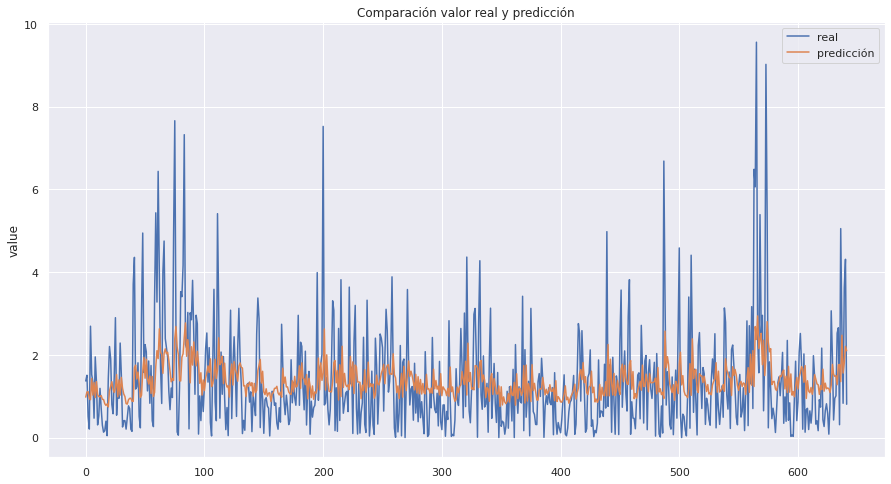

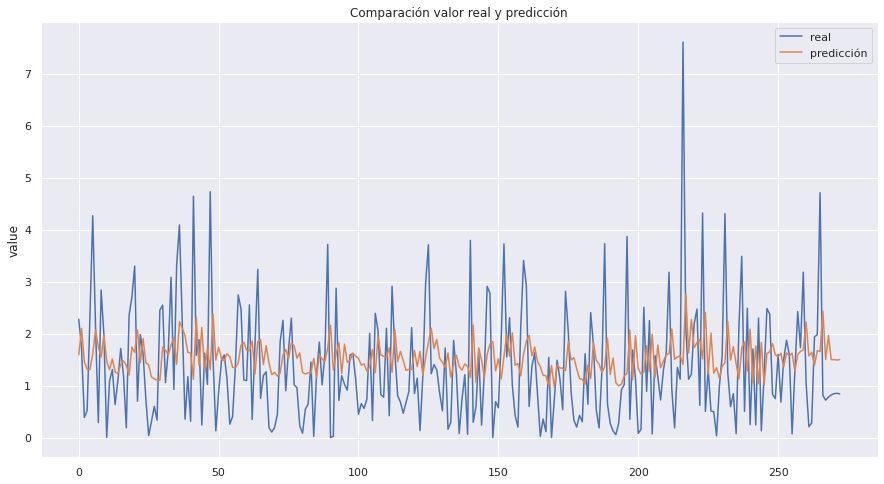

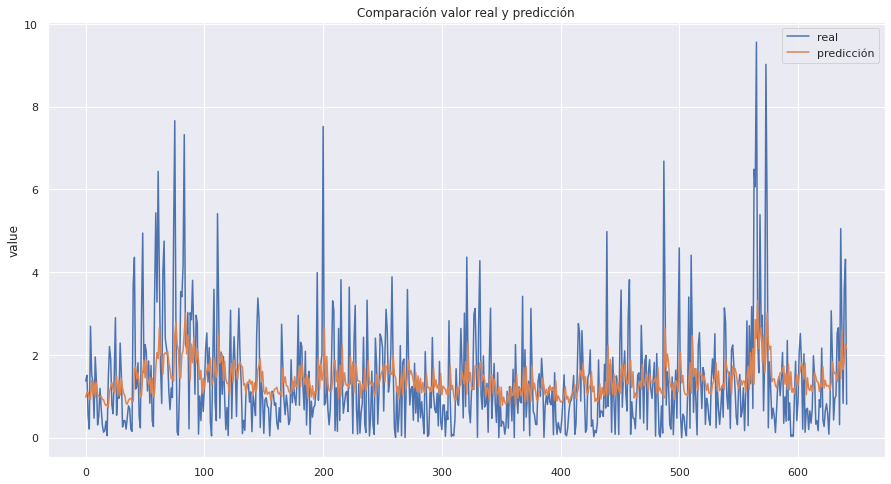

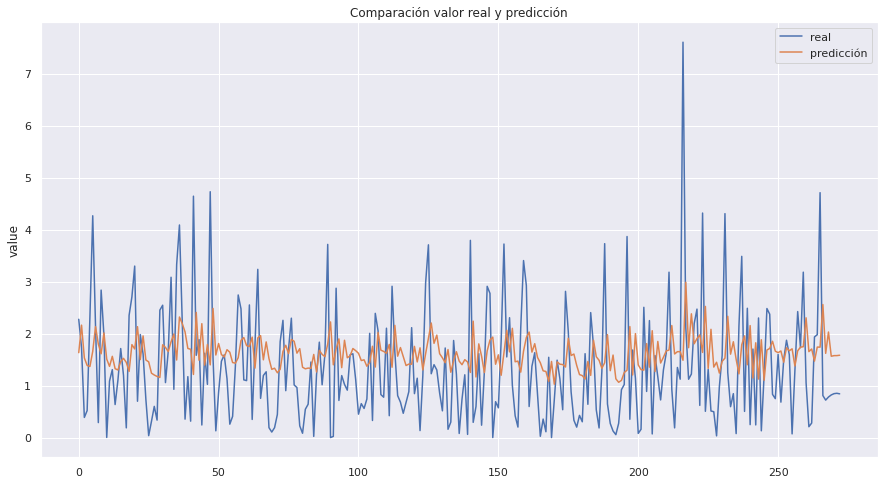

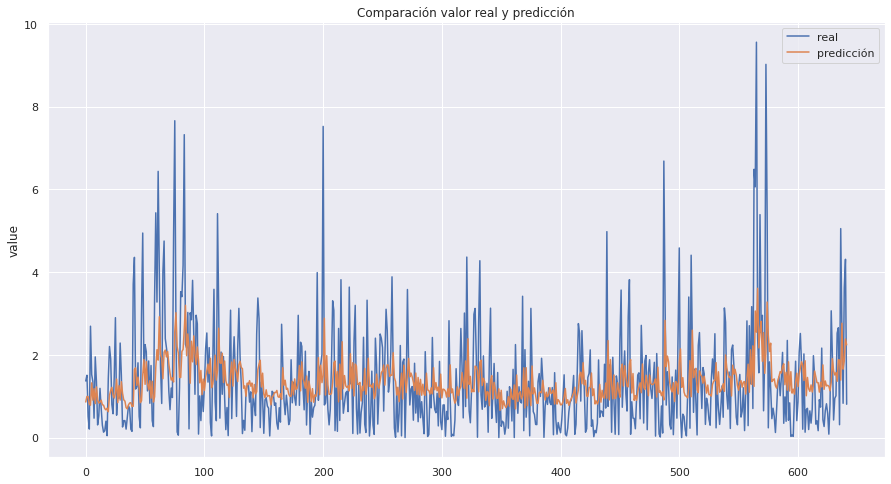

...

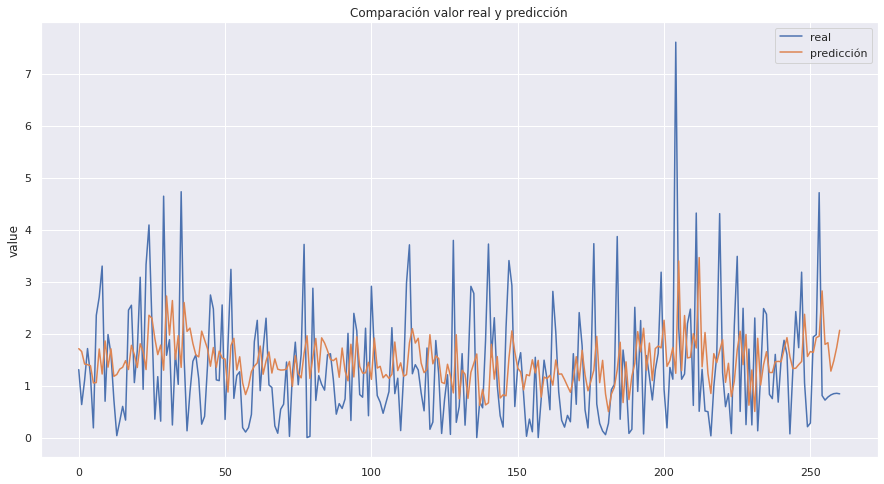

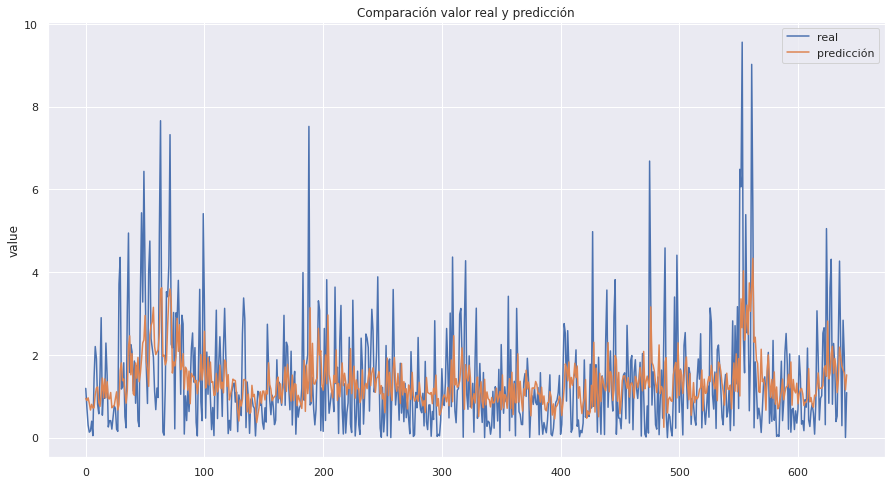

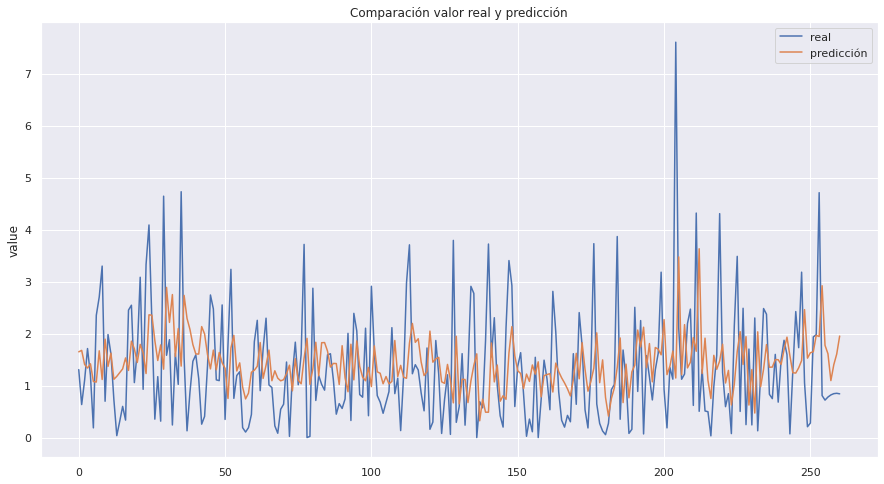

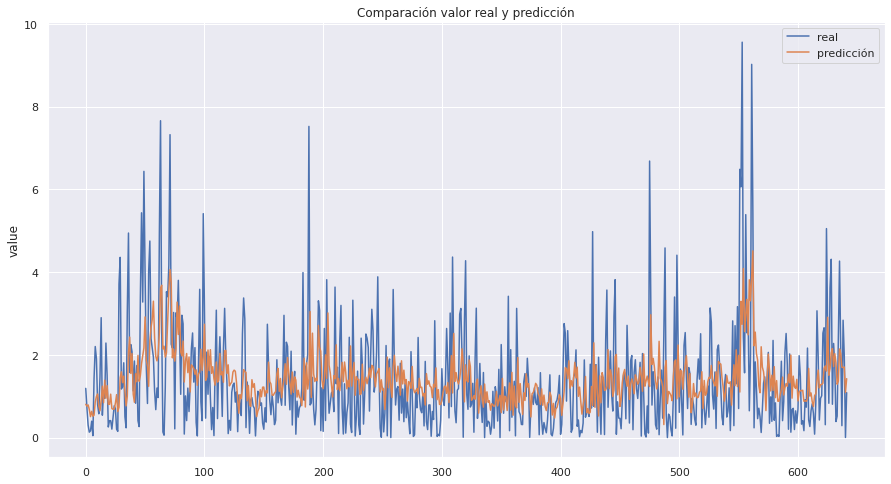

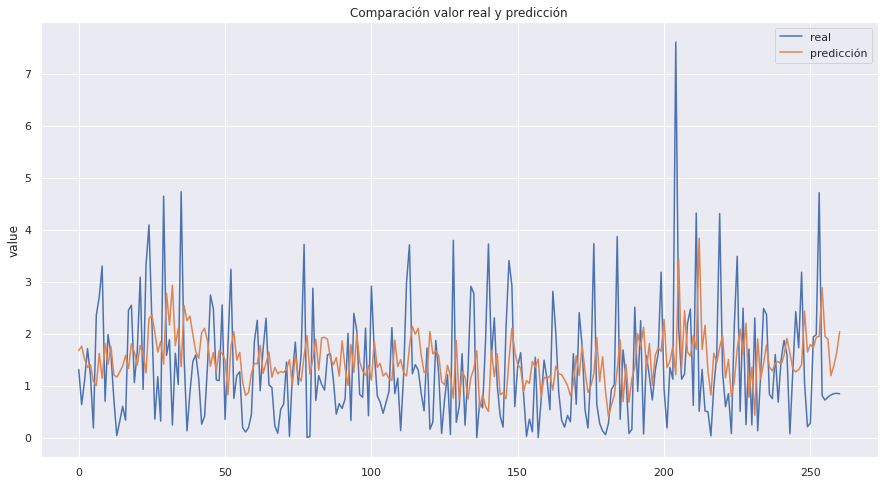

In [11]:
lags=[3,5,7,8,10,15]
n_estimators=[i for i in range(10,100,10)]
n_estimators.extend([200,300,500,2000])
results_models={i:{} for i in lags}
for lg in lags:
    for est in n_estimators:
        results_models[lg][est]=Model(df_data.copy(),df_label.copy(),lg,est)